<a href="https://colab.research.google.com/github/danaSror/The-Art-of-Analyzing-Big-Data/blob/main/The_Art_of_Analyzing_Big_Data_Final_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*🌟* **The Art of Analyzing Big Data**  🌟
---
`Dana Tzror and Ori Simcha`

---
**The purpose of our research is to try to find a correlation between the life events that a certain singer went through, and the information culture he represents and shares with the world**

We will make a comparison for each singer between his life events in relation to three different sources of information:


1️⃣    The singer's lyrics

2️⃣    The pictures of the singer

3️⃣    The tweets he uploads on social networks



> First, we found blogs for singers in the form of unstructured information. We used a scraper tool so that we could analyze the blog pages and extract only relevant information.
The way we extracted the information from the blogs was to look for information attributed to a certain year. In this way we could create structured information:
Year - an event that occurred this year


> After that, we tried to see if there is a match between the events of the singer's life and the lyrics of his songs, his photos and the content of the tweets he posts on social networks.






---

For each dataset we obtained we performed a preliminary analysis to fully understand the information

---



◽ It is necessary to switch to a **GPU** in order to shorten the running times

◽ After completing the installation step the notebook should be restart

#Installing

In [ ]:
!pip install turicreate
!pip install kaggle
!pip install gensim
!pip install pyLDAvis
!pip install spaCy
!pip install afinn
!pip install nltk
!pip install plotly_express
!pip install tensorflow==2.8
!pip install bertopic
!pip install summarizers -q
!pip3 install deepface
!pip install gensim

import nltk
nltk.download('stopwords')
nltk.download('punkt')

!pip install spaCy
!pip install spacy-transformers # we need to install this package before using the transformes models
!python -m spacy download en_core_web_lg # Important! you need to restart runtime after install

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 92.0 MB 1.1 MB/s 
     |████████████████████████████████| 3.5 MB 43.4 MB/s 
     |████████████████████████████████| 322 kB 53.4 MB/s 
     |████████████████████████████████| 86.4 MB 71 kB/s 
     |████████████████████████████████| 3.6 MB 37.0 MB/s 
     |████████████████████████████████| 18.3 MB 478 kB/s 
     |████████████████████████████████| 449 kB 56.7 MB/s 
     |████████████████████████████████| 3.8 MB 34.2 MB/s 
     |████████████████████████████████| 50 kB 8.6 MB/s 
     |████████████████████████████████| 20.1 MB 1.3 MB/s 
     |████████████████████████████████| 2.9 MB 25.0 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=7420620e123abaa7d905368aef43af5089064305aa4115f6508f475aeb9f880f
  Stored in directory: /root/.cache/pip/wheels/b2/7f/f6/f180315b584f00445045ff1699b550fa895d09471337ce21c6

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.7 MB 8.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 15.7 MB 43.3 MB/s 
  Created wheel for pyLDAvis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136898 sha256=f0e022c6cb54721be6bd63b3e9948fbd1a4b04686b60bb91b2b56cd0ed07d5c1
  Stored in directory: /root/.cache/pip/wheels/c9/21/f6/17bcf2667e8a68532ba2fbf6d5c72fdf4c7f7d9abfa4852d2f
  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1310 sha256=4444e0474e5eda986d35a2924ffb08752a2ac8c76f85f60c91ad77914034322e

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 52 kB 1.3 MB/s 
  Created wheel for afinn: filename=afinn-0.1-py3-none-any.whl size=53447 sha256=5bc9d726813bb4ef7fc811ff5bbdef3ff4c071e9a74b2b4aaf8bf9e795e3c5bc
  Stored in directory: /root/.cache/pip/wheels/9d/16/3a/9f0953027434eab5dadf3f33ab3298fa95afa8292fcf7aba75
Successfully built afinn
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 668.3 MB 16 kB/s 
     |████████████████████████████████| 5.8 MB 8.3 MB/s 
     |████████████████████████████████| 462 kB 69.3 MB/s

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 53 kB 2.0 MB/s 
     |████████████████████████████████| 1.1 MB 15.9 MB/s 
2022-08-21 18:23:10.270883: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 587.7 MB 9.0 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


# Timelife events dataset

---
Timelife events of each singer


In [ ]:
from bs4 import BeautifulSoup
import requests
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from afinn import Afinn
nltk.download('stopwords')

afinn = Afinn(emoticons=True)

stop_words_set = set(stopwords.words("english"))


singers = {'Rihanna': 'https://www.nickiswift.com/194782/the-tragic-real-life-story-of-rihanna/',
           'Beyoncé': 'https://www.biography.com/musician/beyonce-knowles',
           'Katy Perry': 'https://www.biography.com/musician/katy-perry',
           'Ed Sheeran': 'https://www.biography.com/musician/ed-sheeran',
           'Eminem': 'https://www.biography.com/musician/eminem',
           'Justin Bieber': 'https://www.biography.com/musician/justin-bieber'}


frames = []
for sng in singers.keys():
    s = requests.get(singers[sng]).content.decode('utf-8')
    html = s
    soup = BeautifulSoup(html, 'html.parser')
    l = soup.findAll('p')  # , attrs={'class': 'google-ad-placeholder between-p'})
    years_txt_dict = {}
    for i in l:
        cleanString = re.sub('[^A-Za-z0-9]+', ' ', i.text)
        text_year_lst = cleanString.split()
        for index in range(len(text_year_lst)):
            if text_year_lst[index].isdigit() and len(text_year_lst[index]) == 4:
                year = text_year_lst[index]
                before_index = min(abs(index - 1), abs(index - 10))
                after_index = min(index + 1, len(text_year_lst)-1)
                _10_words_before_year_set = set(text_year_lst[before_index:index])
                _10_words_after_year_set = set(text_year_lst[after_index:after_index+10])
                if year not in years_txt_dict.keys():
                    years_txt_dict[year] = set()
                    years_txt_dict[year] = _10_words_before_year_set | _10_words_after_year_set
                else:
                    years_txt_dict[year] = years_txt_dict[year] | _10_words_before_year_set | _10_words_after_year_set
    final_dict = {}
    for year,text_set in years_txt_dict.items():
        for word in text_set:
            if not len(word) == 1 and not word.lower() in stop_words_set and not word.isdigit():
                if year not in final_dict.keys():
                    final_dict[year] = ""
                else:
                    final_dict[year] += " " + word

    singer_df = pd.DataFrame(list(final_dict.items()), columns = ['Year', 'Text'])
    singer_df.insert(loc = 0, column = 'Singer', value = [sng for i in range(len(singer_df))])
    frames.append(singer_df)

blogs_result = pd.concat(frames)
blogs_result['Blog Affin Score'] = blogs_result['Text'].apply(lambda t: afinn.score(t))
blogs_result['Year']=blogs_result['Year'].apply(lambda x: int(x))
blogs_result

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,Singer,Year,Text,Blog Affin Score
0,Rihanna,2005,year Robyn Rihanna music broke old onto,-1.0
1,Rihanna,2019,female father musician failed success Complex...,-1.0
2,Rihanna,2011,paid Ronald later told drunk said time outsid...,-2.0
3,Rihanna,2009,rocked school said Allure Brown interview wor...,0.0
4,Rihanna,2015,first happen Harper school told Rihanna survi...,1.0
...,...,...,...,...
11,Justin Bieber,2014,January aposs influence California Bieber alc...,-2.0
12,Justin Bieber,2013,paid image spitting neighbor artist July trib...,-2.0
13,Justin Bieber,2002,album Lavigne burst Avril scene Let Go platin...,0.0
14,Justin Bieber,1997,following album release international Come be...,0.0


## Analysis of the life events of the singers 📈


### 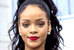 Rihanna

In [ ]:
from summarizers import Summarizers

summ = Summarizers()
Rihanna_blog_df = blogs_result[blogs_result['Singer'] == 'Rihanna' ]
Rihanna_blog_df = Rihanna_blog_df.sort_values(by=['Year'])
Rihanna_blog_df['Text'] = Rihanna_blog_df['Text'].apply(lambda txt: summ(txt))
Rihanna_blog_df

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BartTokenizer'. 
The class this function is called from is 'PreTrainedTokenizerFast'.


,Singer,Year,Text,Blog Affin Score
0,Rihanna,2005,Rihanna broke onto the music scene last year w...,-1.0
7,Rihanna,2008,"""I will send you back to the mansion my forced...",-2.0
3,Rihanna,2009,"In a February interview with Allure, Rihanna s...",0.0
2,Rihanna,2011,"Rolling Stone told Rolling Stone: ""If Vogue we...",-2.0
8,Rihanna,2013,"Rolling Stone, speaking from a Malibu rehab pr...",0.0
4,Rihanna,2015,Harper's Bazaar told that Rihanna's school day...,0.0
9,Rihanna,2016,Rihanna's album Anti went gave full music to n...,-1.0
5,Rihanna,2017,Tavon Fenty lost unauthorized Rihanna America ...,-2.0
1,Rihanna,2019,According to makeup world though father failed...,-1.0
6,Rihanna,2020,There were reports that a jury was due to be s...,-1.0


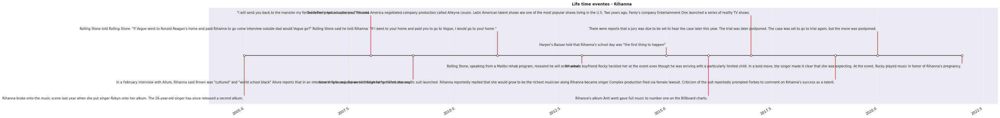

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from datetime import datetime

names = list(Rihanna_blog_df['Text'])
dates = list(Rihanna_blog_df['Year'])

# Choose some nice levels
levels = np.tile([-5, 5, -3, 3, -1, 1],
                 int(np.ceil(len(dates)/6)))[:len(dates)]

# Create figure and plot a stem plot with the date
fig, ax = plt.subplots(figsize=(43, 5), constrained_layout=True)
ax.set()
ax.set_title("Life time eventes - Rihanna  ", fontweight ="bold",loc='center')

ax.vlines(dates, 0, levels, color="tab:red")  # The vertical stems.
ax.plot(dates, np.zeros_like(dates), "-o",
        color="k", markerfacecolor="w")  # Baseline and markers on it.

# annotate lines
for d, l, r in zip(dates, levels, names):
    ax.annotate(r, xy=(d, l),
                xytext=(-3, np.sign(l)*3), textcoords="offset points",
                horizontalalignment="right",
                verticalalignment="bottom" if l > 0 else "top")

plt.setp(ax.get_xticklabels(), rotation=30, ha="right")

# remove y axis and spines
ax.yaxis.set_visible(False)

ax.margins(y=0.1)
plt.show()

### 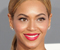  Beyoncé

In [ ]:
from summarizers import Summarizers

summ = Summarizers()
Beyoncé_blog_df = blogs_result[blogs_result['Singer'] == 'Beyoncé' ]
Beyoncé_blog_df = Beyoncé_blog_df.sort_values(by=['Year'])
Beyoncé_blog_df['Text'] = Beyoncé_blog_df['Text'].apply(lambda txt: summ(txt))
Beyoncé_blog_df

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BartTokenizer'. 
The class this function is called from is 'PreTrainedTokenizerFast'.


,Singer,Year,Text,Blog Affin Score
1,Beyoncé,1981,Knowles was born in early Texas and started si...,0.0
2,Beyoncé,1997,Columbia Records became the first record label...,0.0
3,Beyoncé,2001,Carmen Hip made her acting debut starring in H...,0.0
18,Beyoncé,2002,Avril Lavigne's music multi-platinum Canadian ...,0.0
4,Beyoncé,2003,Love became huge success as an album releasing...,6.0
5,Beyoncé,2004,Destiny's Child officially aposs for a second ...,1.0
19,Beyoncé,2005,Rihanna is best known for her album Umbrella a...,0.0
6,Beyoncé,2006,Knowles continued his second success album apo...,7.0
0,Beyoncé,2008,Jay three Knowles album is a hip-hop album. Th...,2.0
7,Beyoncé,2010,Adele tied her career to Knowles event fragran...,8.0


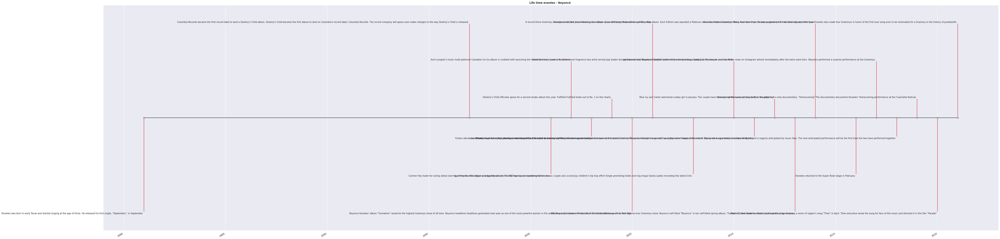

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from datetime import datetime

names = list(Beyoncé_blog_df['Text'])
dates = list(Beyoncé_blog_df['Year'])

# Choose some nice levels
levels = np.tile([-5, 5, -3, 3, -1, 1],
                 int(np.ceil(len(dates)/6)))[:len(dates)]

# Create figure and plot a stem plot with the date
fig, ax = plt.subplots(figsize=(63, 15), constrained_layout=True)
ax.set()
ax.set_title("Life time eventes - Beyoncé  ", fontweight ="bold",loc='center')

ax.vlines(dates, 0, levels, color="tab:red")  # The vertical stems.
ax.plot(dates, np.zeros_like(dates), "-o",
        color="k", markerfacecolor="w")  # Baseline and markers on it.

# annotate lines
for d, l, r in zip(dates, levels, names):
    ax.annotate(r, xy=(d, l),
                xytext=(-3, np.sign(l)*3), textcoords="offset points",
                horizontalalignment="right",
                verticalalignment="bottom" if l > 0 else "top")

plt.setp(ax.get_xticklabels(), rotation=30, ha="right")

# remove y axis and spines
ax.yaxis.set_visible(False)

ax.margins(y=0.1)
plt.show()

### 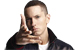 Eminem

In [ ]:
from summarizers import Summarizers

summ = Summarizers()
Eminem_blog_df = blogs_result[blogs_result['Singer'] == 'Eminem' ]
Eminem_blog_df = Eminem_blog_df.sort_values(by=['Year'])
Eminem_blog_df['Text'] = Eminem_blog_df['Text'].apply(lambda txt: summ(txt))
Eminem_blog_df

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BartTokenizer'. 
The class this function is called from is 'PreTrainedTokenizerFast'.


,Singer,Year,Text,Blog Affin Score
0,Eminem,1972,Eminem was born Joseph Bruce Marshall III in t...,-1.0
9,Eminem,1995,The couple dropped Eminem and named their daug...,-1.0
13,Eminem,1996,Eminem released his first independent rap albu...,0.0
14,Eminem,1997,Eminem discovered Rap rapper Dre by starting t...,-1.0
1,Eminem,1999,Dre filed a lawsuit garnering Eminem Interscop...,-3.0
2,Eminem,2000,Marshall Mathers major well Eminem studio seco...,0.0
15,Eminem,2001,Elton John and Eminem demonstrate the reconnec...,3.0
12,Eminem,2002,Eminem's new album is an autobiographical albu...,0.0
19,Eminem,2003,The Academy Awards perform a tribute to the wi...,7.0
11,Eminem,2004,The previous successful song aposs efforts of ...,3.0


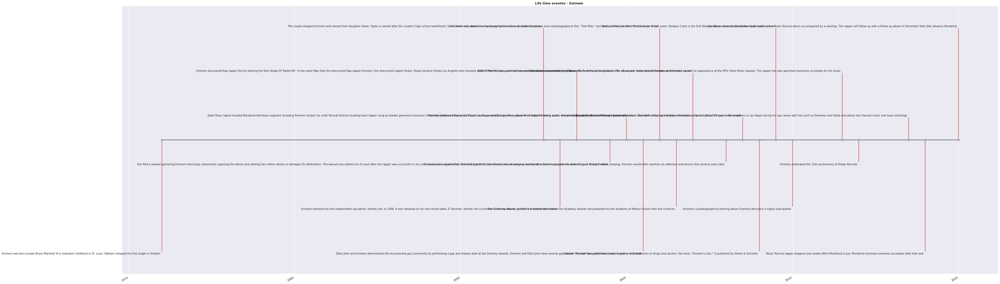

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from datetime import datetime

names = list(Eminem_blog_df['Text'])
dates = list(Eminem_blog_df['Year'])

# Choose some nice levels
levels = np.tile([-5, 5, -3, 3, -1, 1],
                 int(np.ceil(len(dates)/6)))[:len(dates)]

# Create figure and plot a stem plot with the date
fig, ax = plt.subplots(figsize=(53, 15), constrained_layout=True)
ax.set()
ax.set_title("Life time eventes - Eminem  ", fontweight ="bold",loc='center')

ax.vlines(dates, 0, levels, color="tab:red")  # The vertical stems.
ax.plot(dates, np.zeros_like(dates), "-o",
        color="k", markerfacecolor="w")  # Baseline and markers on it.

# annotate lines
for d, l, r in zip(dates, levels, names):
    ax.annotate(r, xy=(d, l),
                xytext=(-3, np.sign(l)*3), textcoords="offset points",
                horizontalalignment="right",
                verticalalignment="bottom" if l > 0 else "top")

plt.setp(ax.get_xticklabels(), rotation=30, ha="right")

# remove y axis and spines
ax.yaxis.set_visible(False)

ax.margins(y=0.1)
plt.show()

### 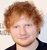 Ed Sheeran

In [ ]:
from summarizers import Summarizers

summ = Summarizers()
Ed_Sheeran_blog_df = blogs_result[blogs_result['Singer'] == 'Ed Sheeran' ]
Ed_Sheeran_blog_df = Ed_Sheeran_blog_df.sort_values(by=['Year'])
Ed_Sheeran_blog_df['Text'] = Ed_Sheeran_blog_df['Text'].apply(lambda txt: summ(txt))
Ed_Sheeran_blog_df

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BartTokenizer'. 
The class this function is called from is 'PreTrainedTokenizerFast'.


,Singer,Year,Text,Blog Affin Score
13,Ed Sheeran,1973,Marvin Gaye claimed to have co-written Ed Shee...,0.0
1,Ed Sheeran,1991,United Kingdom. United Kingdom. Yorkshire and ...,1.0
2,Ed Sheeran,2006,Want Want Want began as a self-titled album. I...,1.0
3,Ed Sheeran,2007,Want Want Want began as a record by two self-t...,1.0
4,Ed Sheeran,2009,Sean can be found playing Sheeran live for ano...,0.0
5,Ed Sheeran,2010,Sheeran fan Jamie Sheeran asked for three more...,12.0
6,Ed Sheeran,2011,"Soon after his last show on Sirius radio, Ed S...",0.0
7,Ed Sheeran,2013,Taylor Swift's One Direction arena tour is cal...,2.0
8,Ed Sheeran,2014,Sheeran winning album Thomas Harrington and so...,2.0
12,Ed Sheeran,2015,Executioner appeared in the series as a recurr...,-5.0


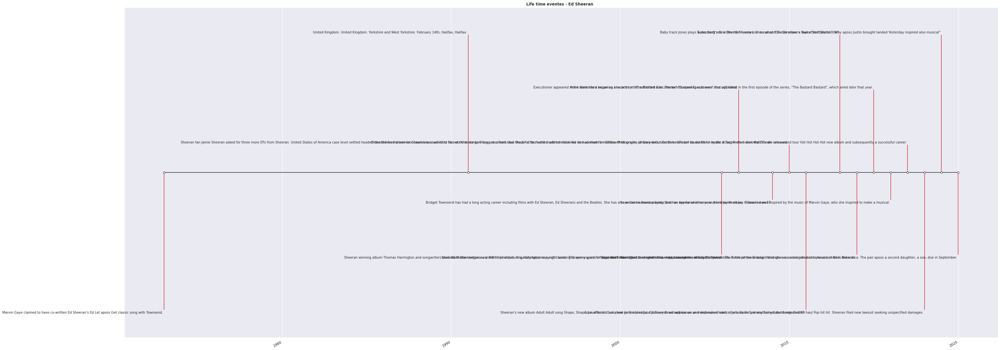

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from datetime import datetime

names = list(Ed_Sheeran_blog_df['Text'])
dates = list(Ed_Sheeran_blog_df['Year'])

# Choose some nice levels
levels = np.tile([-5, 5, -3, 3, -1, 1],
                 int(np.ceil(len(dates)/6)))[:len(dates)]

# Create figure and plot a stem plot with the date
fig, ax = plt.subplots(figsize=(43, 15), constrained_layout=True)
ax.set()
ax.set_title("Life time eventes - Ed Sheeran  ", fontweight ="bold",loc='center')

ax.vlines(dates, 0, levels, color="tab:red")  # The vertical stems.
ax.plot(dates, np.zeros_like(dates), "-o",
        color="k", markerfacecolor="w")  # Baseline and markers on it.

# annotate lines
for d, l, r in zip(dates, levels, names):
    ax.annotate(r, xy=(d, l),
                xytext=(-3, np.sign(l)*3), textcoords="offset points",
                horizontalalignment="right",
                verticalalignment="bottom" if l > 0 else "top")

plt.setp(ax.get_xticklabels(), rotation=30, ha="right")

# remove y axis and spines
ax.yaxis.set_visible(False)

ax.margins(y=0.1)
plt.show()

# Sources of information culture

## Songs dataset

In [ ]:
import json
import os
import pandas as pd

!mkdir /root/.kaggle/


# Installing the Kaggle package
!pip install kaggle

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
# api_token = "put here your api token"
api_token = {"username":"ori1232","key":"dfcc74f1a237d4ba79c4233ce5f91c5a"}


# creating kaggle.json file with the personal API-Key details
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json


!mkdir ./datasets
!mkdir ./datasets/Songs_Lyrics

# download the dataset from Kaggle and unzip it
!kaggle datasets download deepshah16/song-lyrics-dataset -p ./datasets/Songs_Lyrics
!unzip ./datasets/Songs_Lyrics/*.zip  -d ./datasets/Songs_Lyrics/



singers= []
directory = './datasets/Songs_Lyrics/csv/'
Female =  ['Beyonce','BillieEilish' , 'ArianaGrande' , 'CardiB' , 'DuaLipa' , 'KatyPerry' , 'LadyGaga', 'NickiMinaj', 'Rihanna' , 'SelenaGomez' ,'TaylorSwift' ]
Male   = ['CharliePuth' , 'Drake' , 'EdSheeran' ,'Eminem' , 'JustinBieber' , 'Khalid' , 'PostMalone']
Band   = ['BTS', 'ColdPlay' , 'Maroon5']

first = True

for i, filename in enumerate(os.scandir(directory)):
    if filename.is_file():
     if filename.name[:-4] != 'BTS':
      if first:
        kaggle_df = pd.DataFrame(columns =['Artist', 'Title', 'Album', 'Year', 'Date' , 'Lyric', 'Type'])
        first = False

      dfcsv = pd.read_csv(filename.path,header = 0 )#,  names = ['Artist', 'Title', 'Album', 'Year', 'Date' , 'Lyric'] )

      if(str(filename.name[:-4]) in Female):
        dfcsv['Type'] = 'Single - Female'

      elif (str(filename.name[:-4])) in Male:
          dfcsv['Type'] = 'Single - Male'

      elif (str(filename.name[:-4]) )in Band:
          dfcsv['Type'] = 'Band'

      kaggle_df = pd.concat([kaggle_df[['Artist', 'Title', 'Album', 'Year', 'Date' , 'Lyric' ,'Type' ]], dfcsv[['Artist', 'Title', 'Album', 'Year', 'Date' , 'Lyric','Type']]], ignore_index = True, axis = 0)

kaggle_df = kaggle_df[kaggle_df['Year'] != 'None']
kaggle_df = kaggle_df.dropna(subset=['Year'])
kaggle_df['Year'] = kaggle_df['Year'].apply(lambda x: int(x))
kaggle_df = kaggle_df[kaggle_df['Year'] > 1981]
kaggle_df[['Artist','Title','Album','Lyric','Type']] = kaggle_df[['Artist',	'Title', 'Album','Lyric','Type']].astype(str)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
 45% 9.00M/19.9M [00:00<00:00, 13.8MB/s]
100% 19.9M/19.9M [00:00<00:00, 27.7MB/s]
Archive:  ./datasets/Songs_Lyrics/song-lyrics-dataset.zip
  inflating: ./datasets/Songs_Lyrics/csv/ArianaGrande.csv  
  inflating: ./datasets/Songs_Lyrics/csv/BTS.csv  
  inflating: ./datasets/Songs_Lyrics/csv/Beyonce.csv  
  inflating: ./datasets/Songs_Lyrics/csv/BillieEilish.csv  
  inflating: ./datasets/Songs_Lyrics/csv/CardiB.csv  
  inflating: ./datasets/Songs_Lyrics/csv/CharliePuth.csv  
  inflating: ./datasets/Songs_Lyrics/csv/ColdPlay.csv  
  inflating: ./datasets/Songs_Lyrics/csv/Drake.csv  
  inflating: ./datasets/Songs_Lyrics/csv/DuaLipa.csv  
  inflating: ./datasets/Songs_Lyrics/csv/EdSheeran.csv  
  inflating: ./datasets/Songs_Lyrics/csv/Eminem.csv  
  inflating: ./datasets/Songs_Lyrics/csv/JustinBieber.csv  
  inflating: ./datasets/Songs_Lyrics/csv/KatyPerry.csv  
  inflating: ./datasets/Songs_

### Sensitivity analysis of songs in relation to women/men/bands

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import turicreate.aggregate as agg
import turicreate as tc
import pandas as pd
from afinn import Afinn
afinn = Afinn(emoticons=True)

kaggle_df['afinn_score'] = kaggle_df['Lyric'].apply(lambda t: afinn.score(str(t)))
kaggle_df['afinn_score']= pd.to_numeric(kaggle_df['afinn_score'])
kaggle_df = kaggle_df[kaggle_df['Year'] != 'None']
kaggle_df['Year']= pd.to_numeric(kaggle_df['Year'])


In this graph we can see that the distribution of the man's data is more negative than the woman's

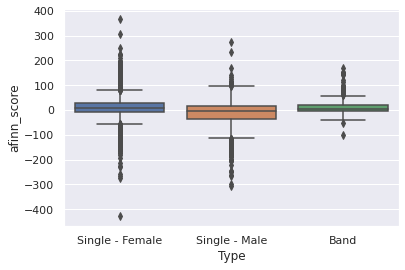

In [ ]:
import seaborn as sns
%matplotlib inline
sns.set()

ax = sns.boxplot(x="Type", y="afinn_score", data=kaggle_df)

In [ ]:
from nltk import word_tokenize

kaggle_df['NumberOfWords']= kaggle_df['Lyric'].apply(lambda txt : len(word_tokenize(str(txt))))

We can see in the following graph that the average song lengths between men and women are relatively the same

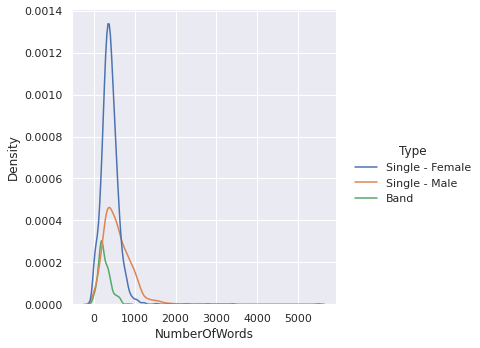

In [ ]:
import seaborn as sns
%matplotlib inline
sns.set()

sns.displot(data=kaggle_df, x="NumberOfWords" ,  kind="kde" , hue = 'Type' )

**We can see that in general by average calculation the lyrics of female performers are usually more positive in relation to the band and men**

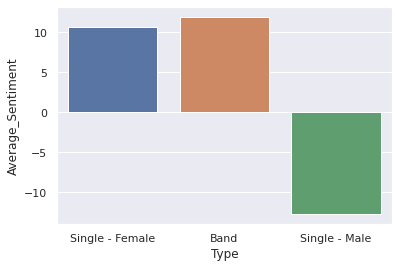

In [ ]:
import turicreate.aggregate as agg
import turicreate as tc

sf = tc.SFrame(kaggle_df)
g = sf.groupby(['Type'], {'Average_Sentiment':agg.AVG('afinn_score')})
df_tmp = g.to_dataframe()
ax = sns.barplot(x="Type", y="Average_Sentiment", data=df_tmp)

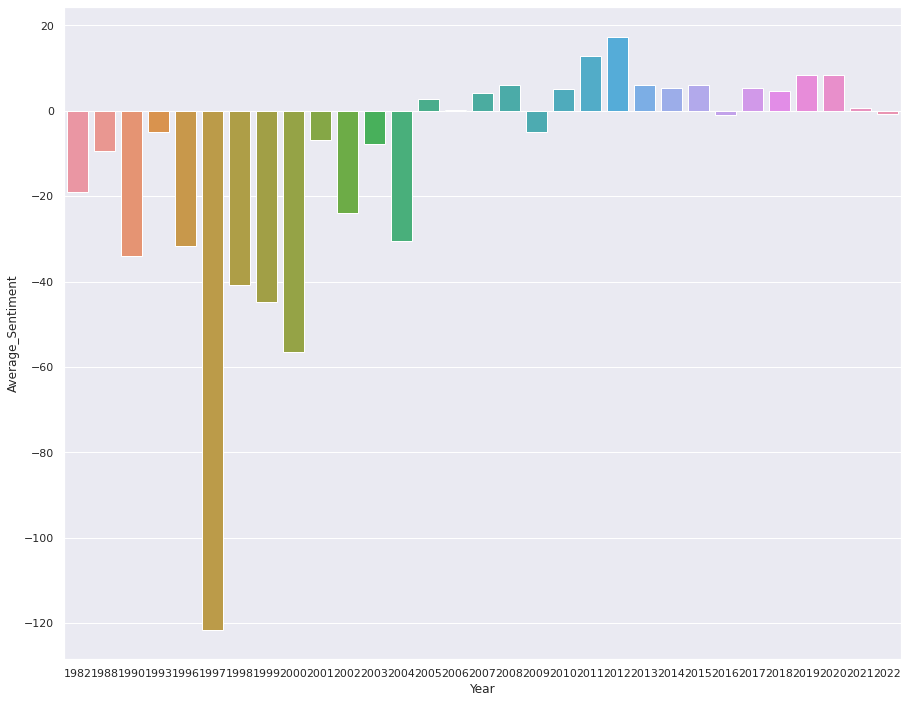

In [ ]:
plt.figure(figsize=(15, 12))

g = sf.groupby(['Year'], {'Average_Sentiment':agg.AVG('afinn_score')})
df_tmp = g.to_dataframe()

ax = sns.barplot(x="Year", y="Average_Sentiment", data=df_tmp)

Representation of women over the years

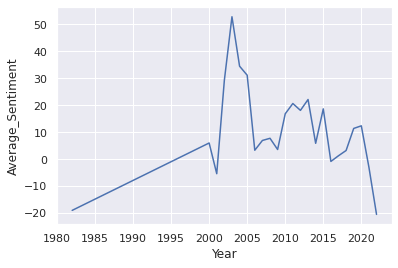

In [ ]:
df_OnlyWomen = kaggle_df[kaggle_df['Type']== 'Single - Female']
sf = tc.SFrame(df_OnlyWomen)
g = sf.groupby(['Year'], {'Average_Sentiment':agg.AVG('afinn_score')})
df_tmp = g.to_dataframe()

sns.lineplot(x="Year", y="Average_Sentiment",data=df_tmp)

Representation of only men over the years

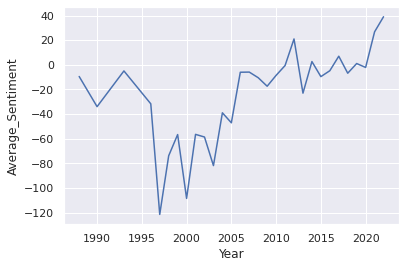

In [ ]:
df_OnlyMen = kaggle_df[kaggle_df['Type']== 'Single - Male']
sf = tc.SFrame(df_OnlyMen)

g = sf.groupby(['Year'], {'Average_Sentiment':agg.AVG('afinn_score')})
df_tmp = g.to_dataframe()
sns.lineplot(x="Year", y="Average_Sentiment",data=df_tmp)

Representation of men and women together over the years

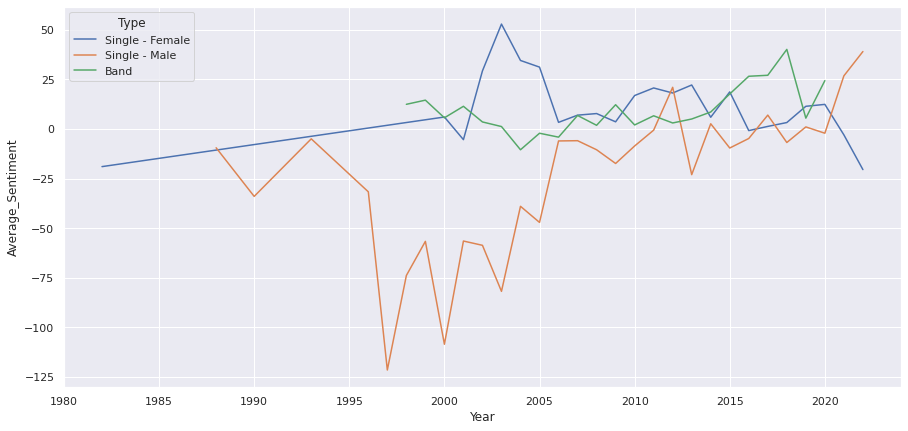

In [ ]:
agg_df = kaggle_df
agg_df = agg_df.dropna(subset=['Year'])
agg_df = agg_df.sort_values(by=['Year'])
agg_df = kaggle_df[['Type','Year','afinn_score']]
sf = tc.SFrame(agg_df)
g = sf.groupby(['Type','Year'], {'Average_Sentiment':agg.AVG('afinn_score')})
agg_df_by_type = g.to_dataframe()

plt.figure(figsize=(15,7))
sns.lineplot(x="Year", y="Average_Sentiment",hue="Type",data=agg_df_by_type)

In [ ]:
import seaborn as sns

sent_df = kaggle_df
sent_df['Content'] = sent_df['afinn_score'].apply(lambda x: "Positive" if x > 0 else "Negative")
sent_df = sent_df[['Artist','Type','Content']]

content_dummies = pd.get_dummies(sent_df['Content'],drop_first=False)
df_sum_of_emotions = pd.concat([sent_df,content_dummies],axis=1)
df_sum_of_emotions = df_sum_of_emotions.drop('Content',axis=1)


negative_df = df_sum_of_emotions.groupby(['Artist','Type'])['Negative'].sum().reset_index(name='Negative sum')
positive_df = df_sum_of_emotions.groupby(['Artist','Type'])['Positive'].sum().reset_index(name='Positive sum')
emotion_df = pd.concat([negative_df,positive_df['Positive sum'] ],axis=1)

artist_df = emotion_df
artist_df['Songs Content'] = pd.Series()
for idx in artist_df.index:
  if artist_df['Positive sum'][idx] >= artist_df['Negative sum'][idx]:
    artist_df['Songs Content'][idx] = 'Positive'
  if artist_df['Positive sum'][idx] < artist_df['Negative sum'][idx]:
    artist_df['Songs Content'][idx] = 'Negative'


artist_df = artist_df.drop(['Positive sum','Negative sum'],axis=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


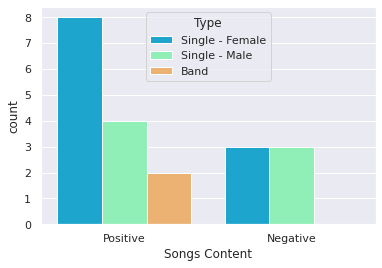

In [ ]:
sns.countplot(x='Songs Content',hue='Type',data=artist_df,palette='rainbow');

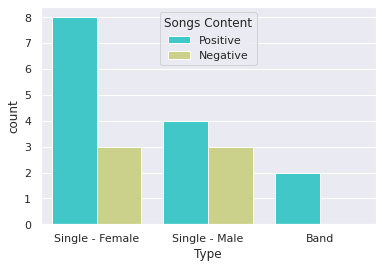

In [ ]:
sns.countplot(x='Type',hue='Songs Content',data=artist_df,palette='rainbow')

**Now, we will create separate graphs. One for singers with positive song content, and the other for singers with negative song content.**

In [ ]:
import turicreate
from turicreate import SFrame
import networkx as nx

sf = SFrame(data=artist_df)
g_content = nx.Graph() # Creating Undirected Graph
# adding all nodes and vertices at once
g_content.add_edges_from([(r['Artist'],r['Songs Content']) for r in sf])
print(nx.info(g_content))
nx.write_gml(g_content, "./datasets/songs_content.gml")

Graph with 22 nodes and 20 edges


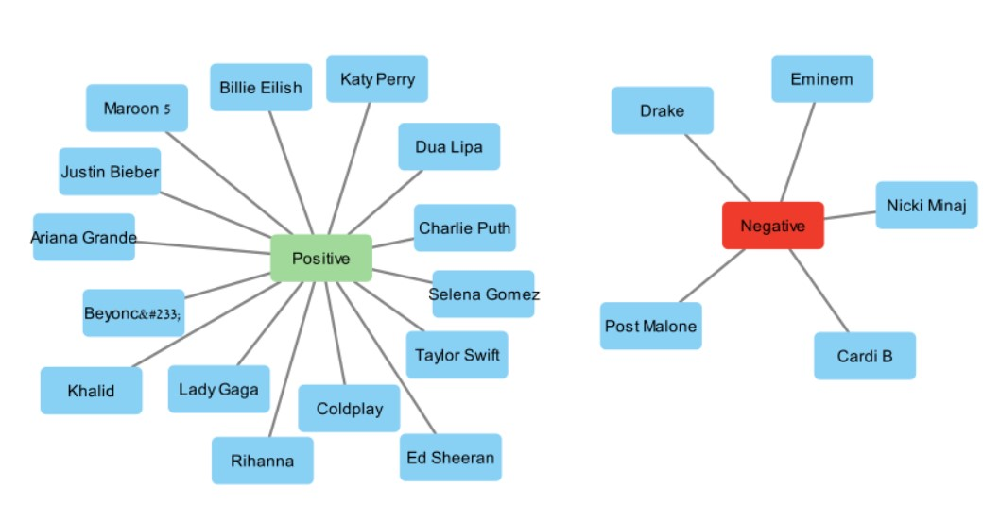

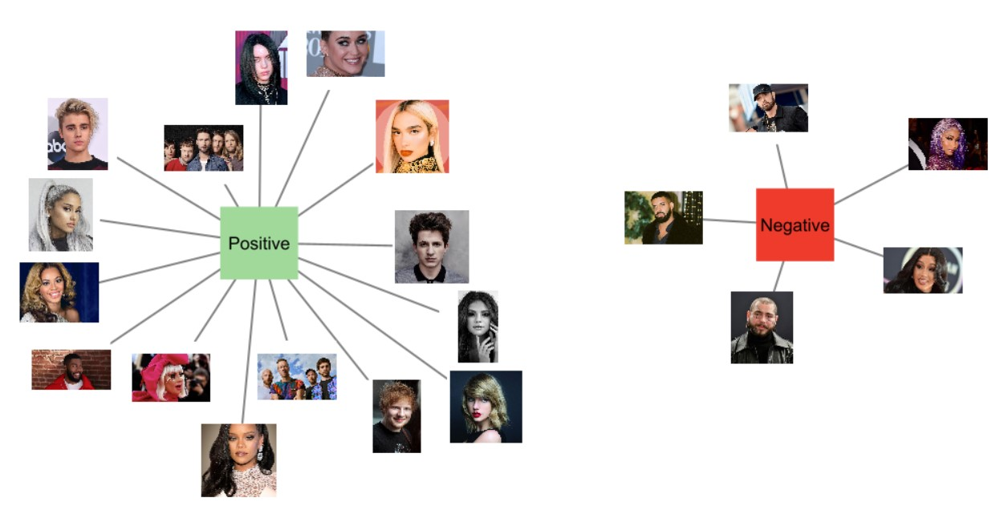

### Characterizing the song performers through the content of their songs ⤹˚˖♬୭

In [ ]:
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
from nltk.corpus import stopwords
from collections import Counter
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import matplotlib.pyplot as mp
import turicreate
from turicreate import SFrame
%matplotlib inline

def draw_artist_word_cloud(artist_dict):
    wordcloud = WordCloud(width = 800, height = 800,background_color ='white',stopwords = stop_words_set,min_font_size = 10)
    # using the subject frquencies
    wordcloud.generate_from_frequencies(frequencies=artist_dict)
    plt.figure(figsize = (7, 7), facecolor = None)
    plt.imshow(wordcloud)

lyric_df = kaggle_df[['Artist','Year','Lyric']]
lyric_df = lyric_df.dropna(subset=['Lyric'])

stop_words_set = set(stopwords.words("english"))

Artist_list = lyric_df['Artist'].unique()
artists_dict = {}

for artist in Artist_list:
  all_songs_lyric = ""
  for idx in lyric_df.index:
    if lyric_df['Artist'][idx] == artist:
      all_songs_lyric += lyric_df['Lyric'][idx]
  artists_dict[artist] = all_songs_lyric.lower()

artists_df2 =  pd.DataFrame(list(artists_dict.items()),columns = ['artists name','all_songs_lyric'])
sf = SFrame(data=artists_df2)

sf['words_1grams'] = tc.text_analytics.count_ngrams(sf['all_songs_lyric'], n=1, method='word')
sf['words_2grams'] = tc.text_analytics.count_ngrams(sf['all_songs_lyric'], n=2, method='word')
sf['words_3grams'] = tc.text_analytics.count_ngrams(sf['all_songs_lyric'], n=3, method='word')

sf['words_1grams'] = sf['words_1grams'].apply(lambda d: {k:v for k,v in d.items() if v > 5 and k not in stop_words_set})
sf['words_2grams'] = sf['words_2grams'].apply(lambda d: {k:v for k,v in d.items() if v > 5 and k not in stop_words_set})
sf['words_3grams'] = sf['words_3grams'].apply(lambda d: {k:v for k,v in d.items() if v > 5 and k not in stop_words_set})
sf.materialize()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### N grams wordcloud graph

 #### **1️⃣ grams wordcloud graph for each artist**

Artist: Ariana Grande


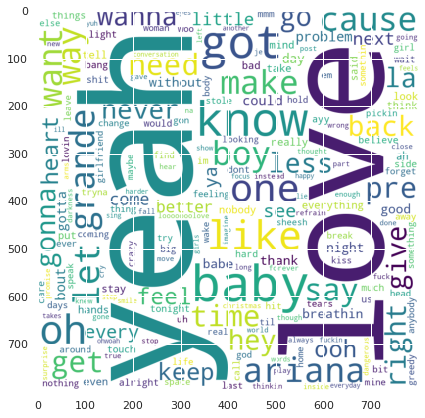


Artist: Charlie Puth


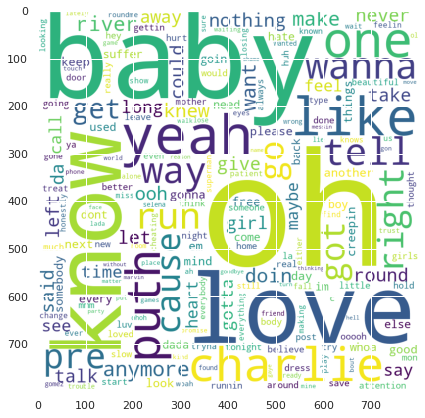


Artist: Justin Bieber


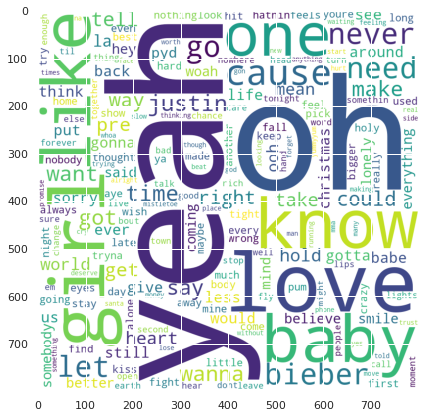


Artist: Katy Perry


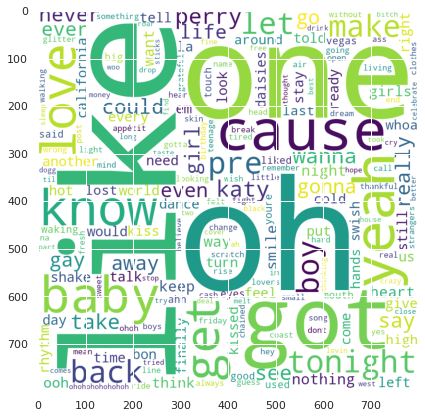


Artist: Cardi B


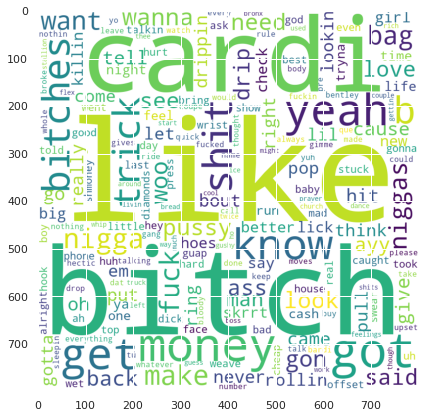


Artist: Nicki Minaj


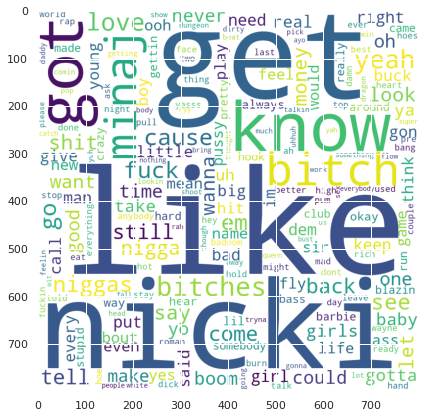


Artist: Maroon 5


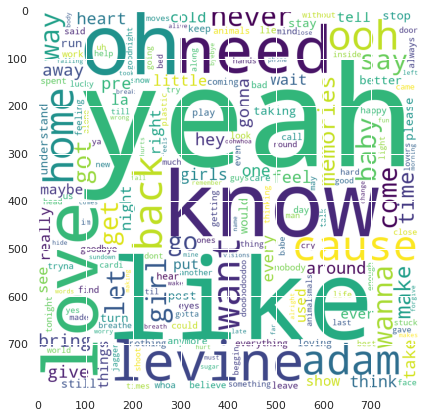


Artist: Selena Gomez


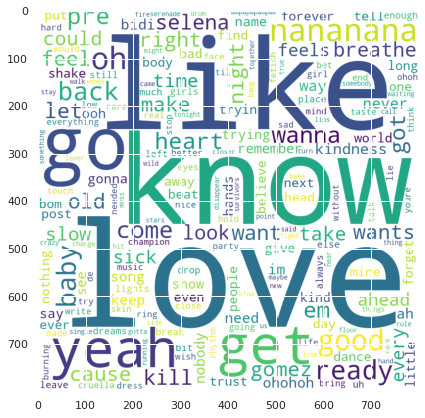


Artist: Drake


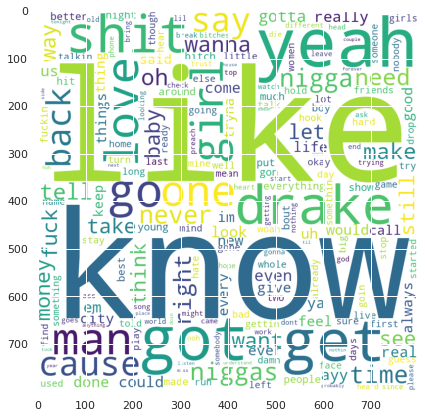


Artist: Taylor Swift


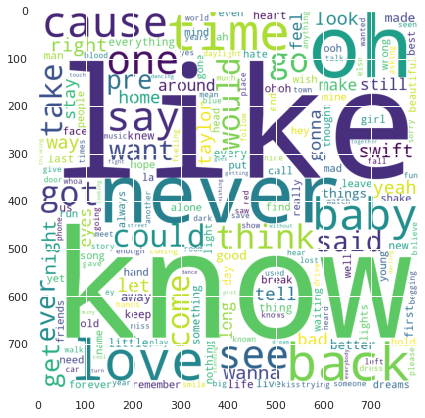


Artist: Eminem


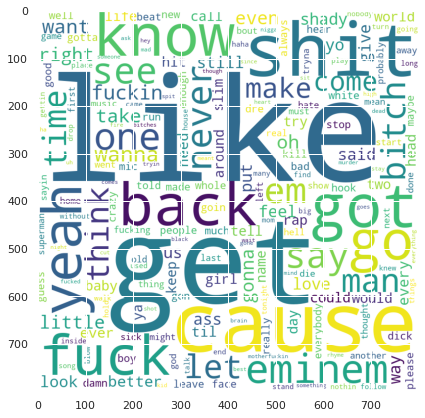


Artist: Beyoncé


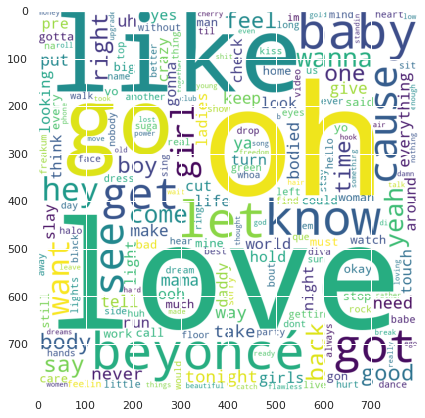


Artist: Coldplay


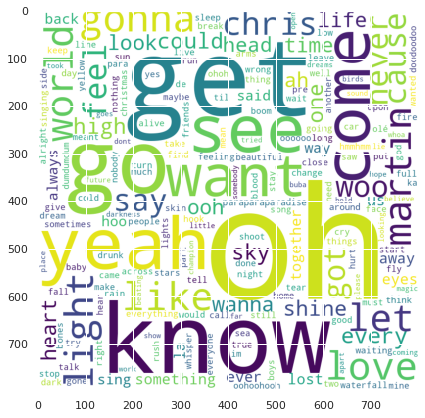


Artist: Post Malone


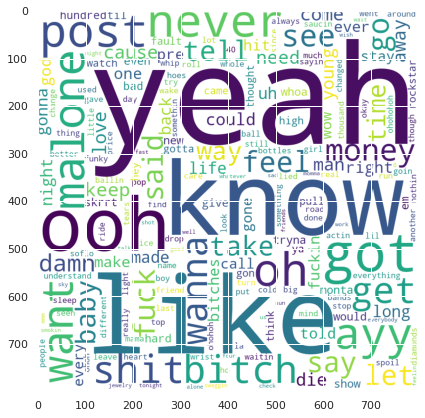


Artist: Ed Sheeran


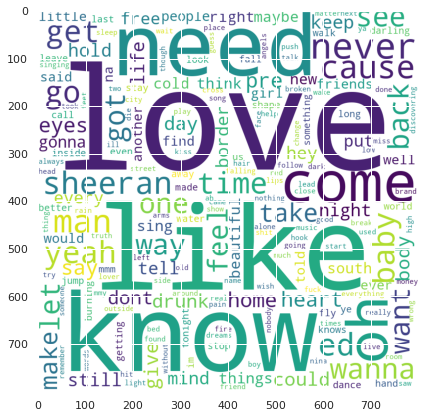


Artist: Khalid


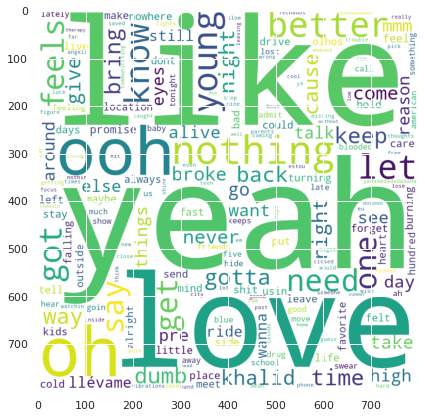


Artist: Dua Lipa


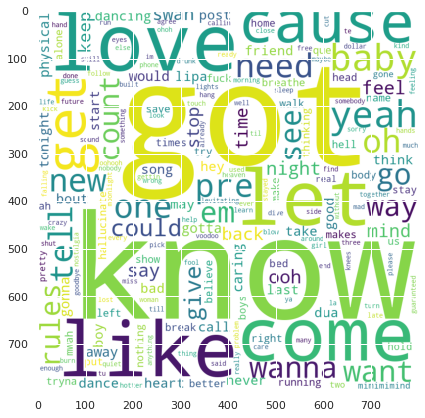


Artist: Billie Eilish


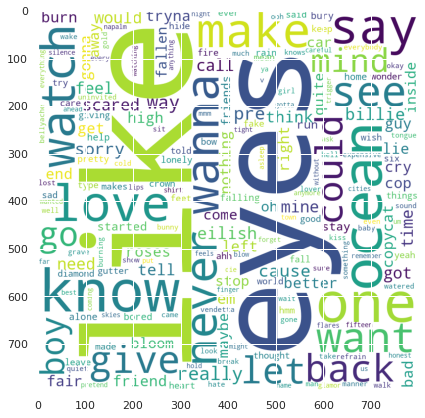


Artist: Lady Gaga


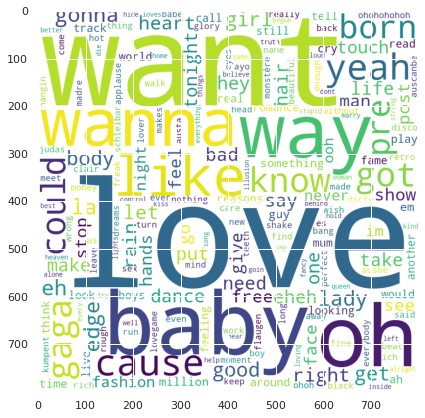


Artist: Rihanna


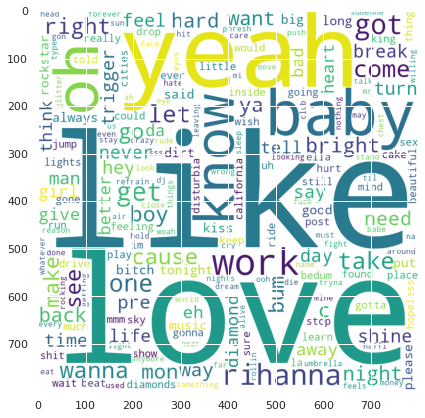

In [ ]:
for row in sf:
  print("Artist: {}".format(row['artists name']))
  draw_artist_word_cloud(row['words_1grams'])
  mp.show()
  print()

#### **2️⃣ grams wordcloud graph for each artist**

Artist: Ariana Grande


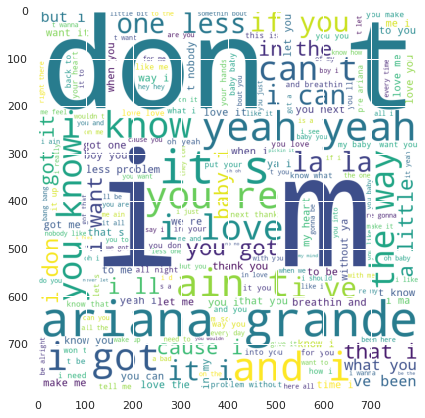


Artist: Charlie Puth


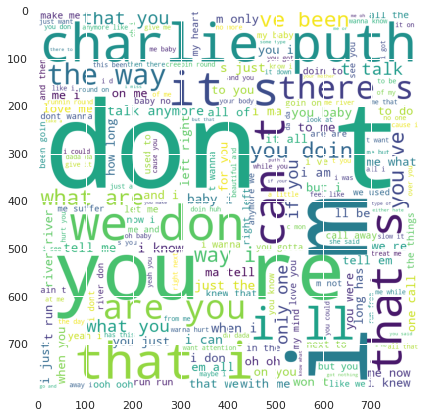


Artist: Justin Bieber


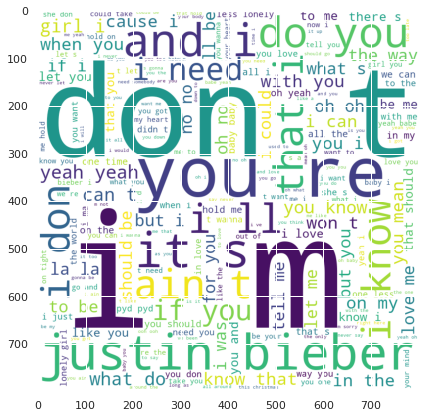


Artist: Katy Perry


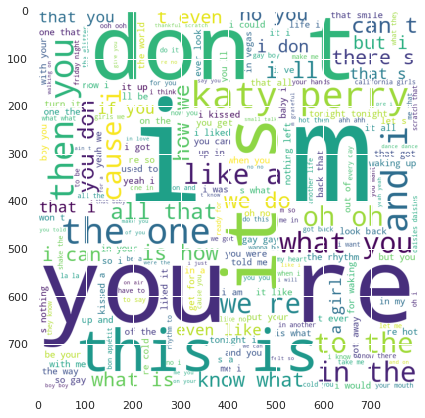


Artist: Cardi B


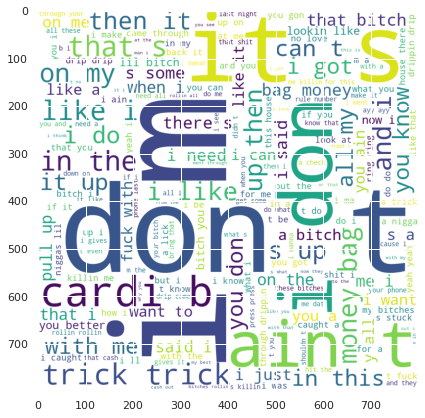


Artist: Nicki Minaj


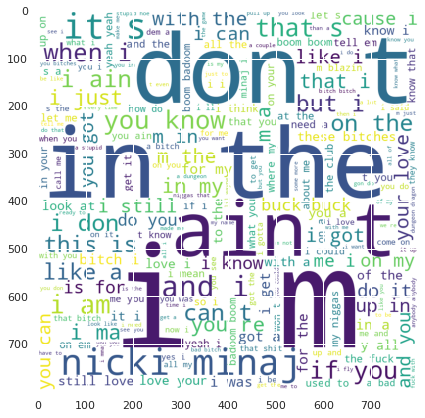


Artist: Maroon 5


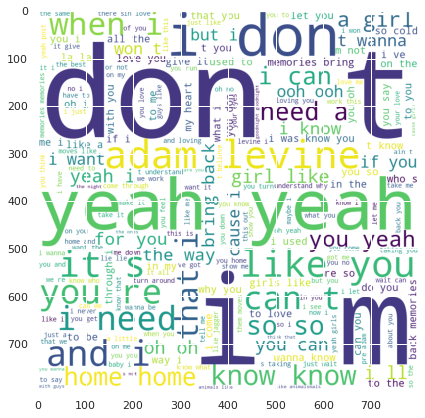


Artist: Selena Gomez


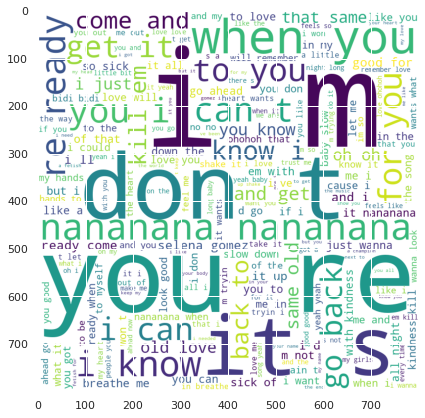


Artist: Drake


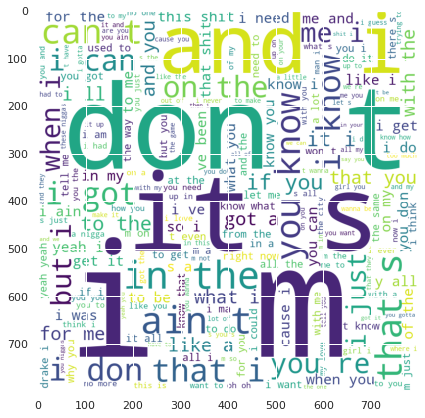


Artist: Taylor Swift


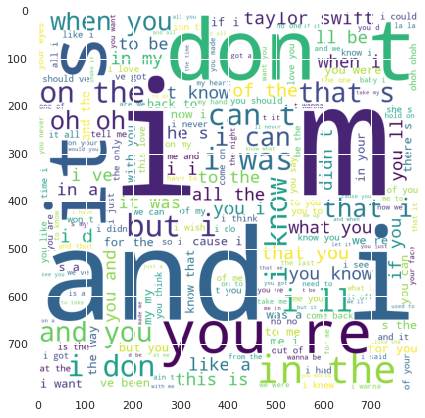


Artist: Eminem


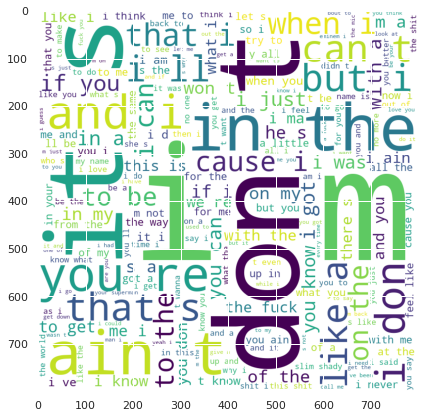


Artist: Beyoncé


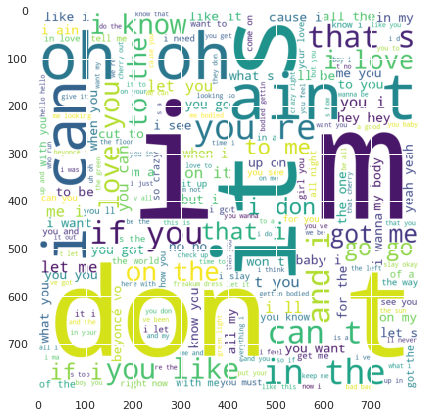


Artist: Coldplay


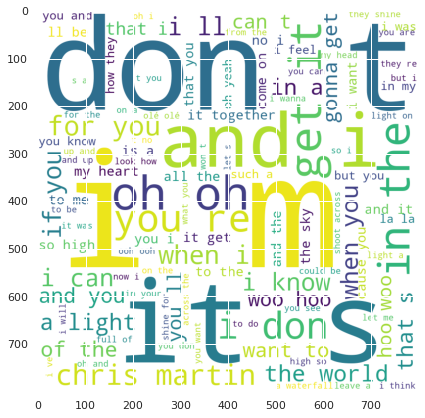


Artist: Post Malone


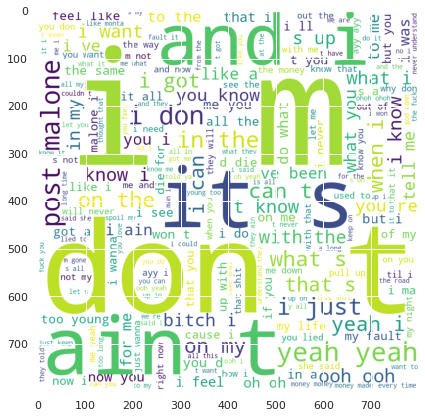


Artist: Ed Sheeran


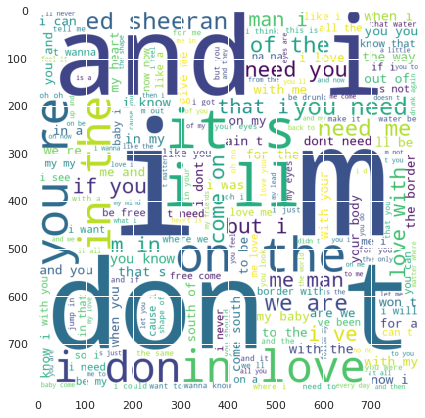


Artist: Khalid


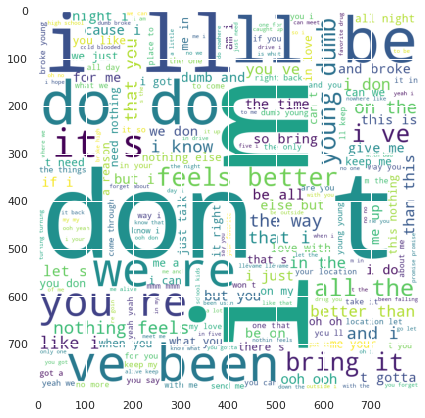


Artist: Dua Lipa


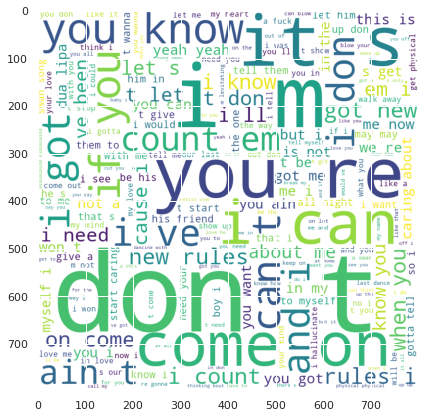


Artist: Billie Eilish


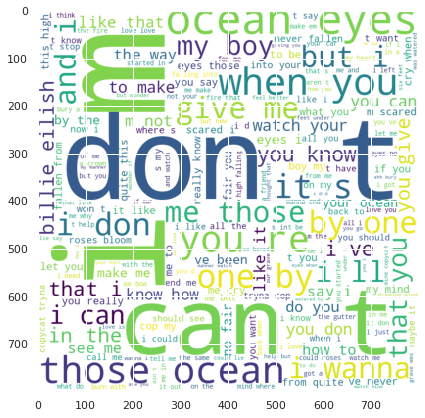


Artist: Lady Gaga


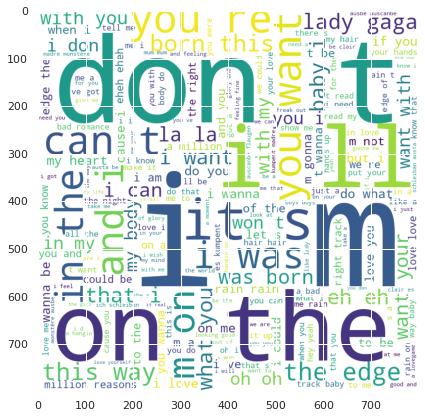


Artist: Rihanna


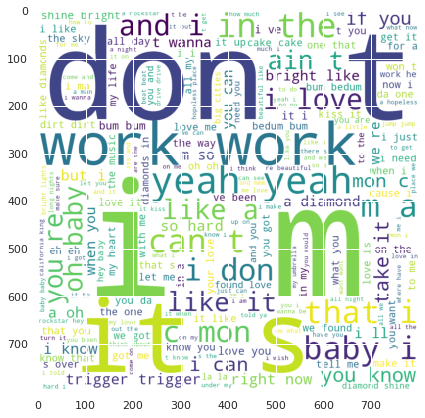

In [ ]:
for row in sf:
  print("Artist: {}".format(row['artists name']))
  draw_artist_word_cloud(row['words_2grams'])
  mp.show()
  print()

#### **3️⃣ grams wordcloud graph for each artist**

Artist: Ariana Grande


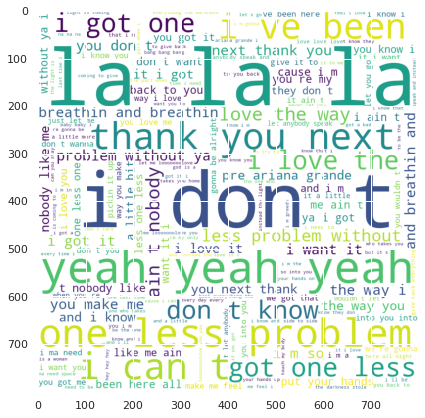


Artist: Charlie Puth


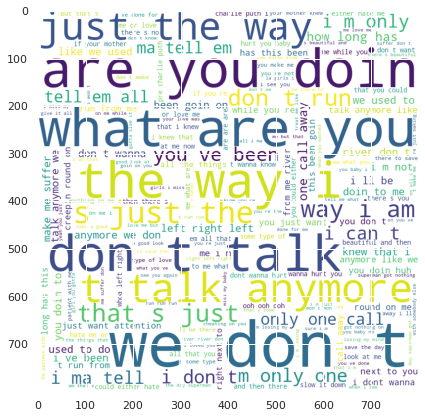


Artist: Justin Bieber


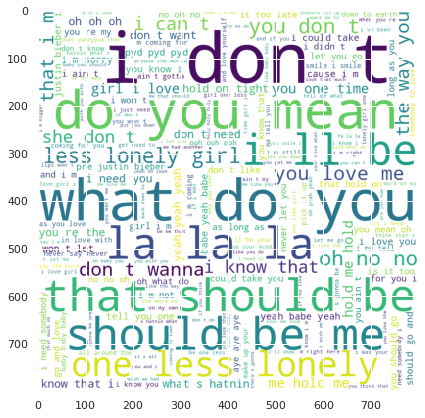


Artist: Katy Perry


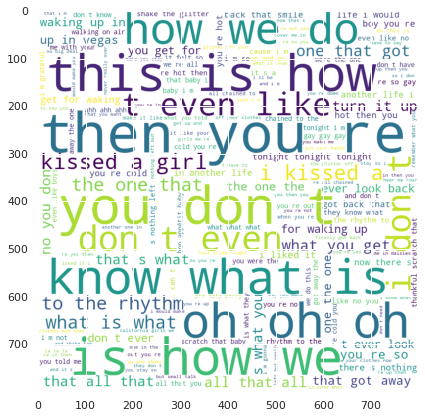


Artist: Cardi B


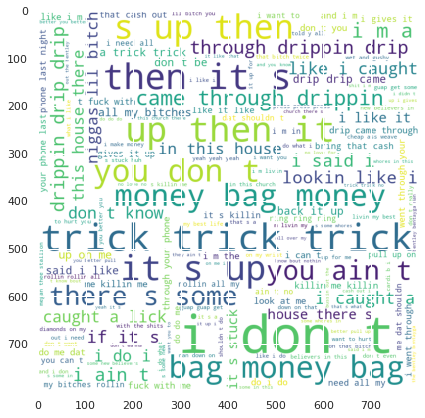


Artist: Nicki Minaj


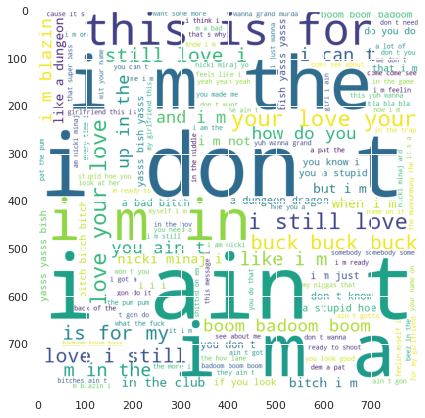


Artist: Maroon 5


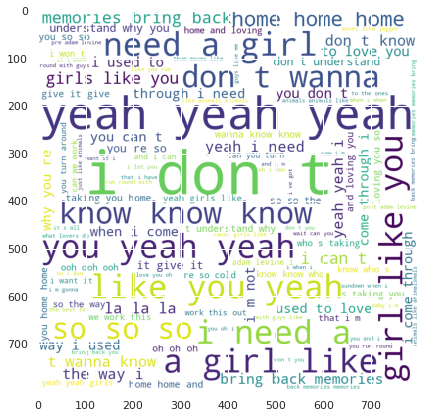


Artist: Selena Gomez


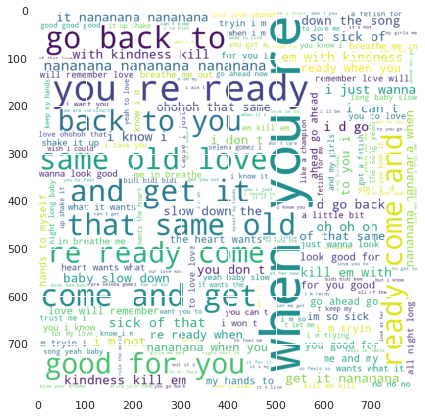


Artist: Drake


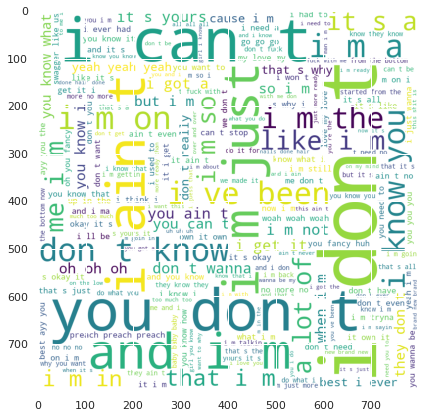


Artist: Taylor Swift


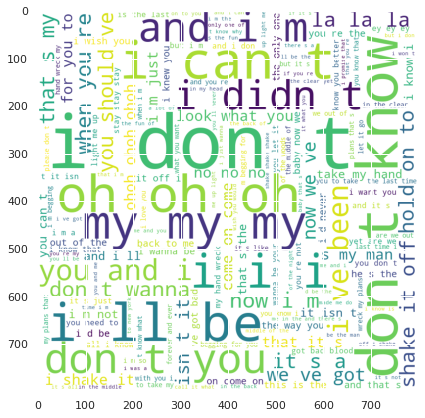


Artist: Eminem


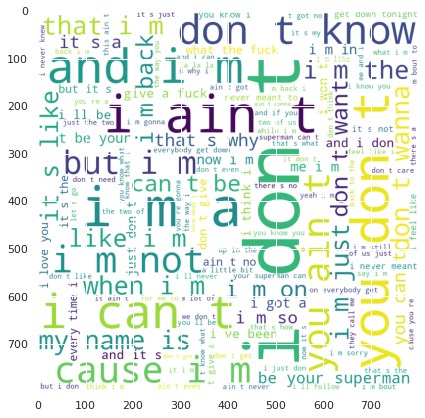


Artist: Beyoncé


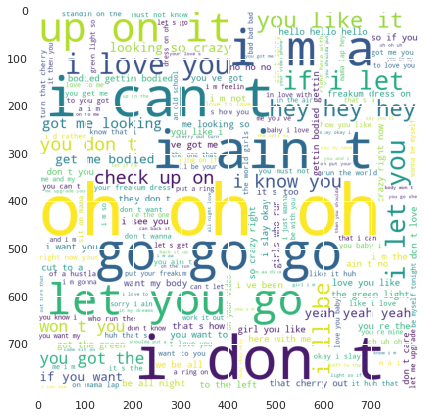


Artist: Coldplay


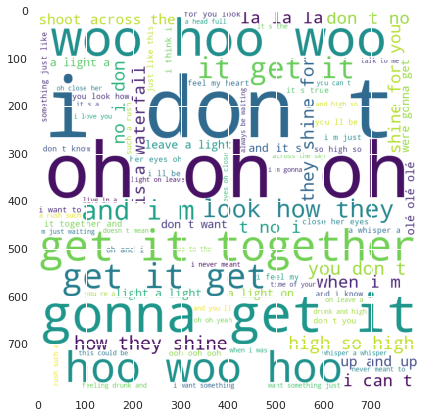


Artist: Post Malone


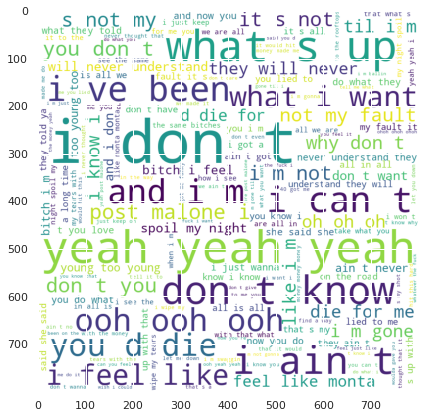


Artist: Ed Sheeran


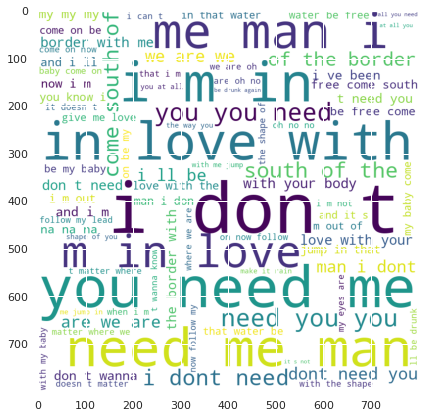


Artist: Khalid


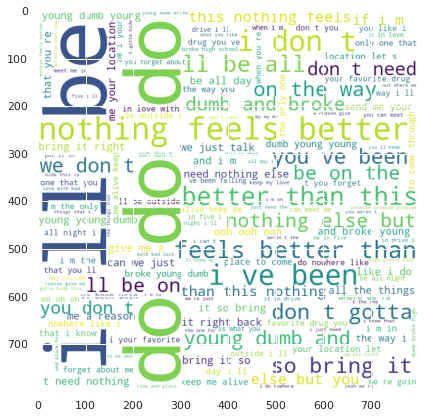


Artist: Dua Lipa


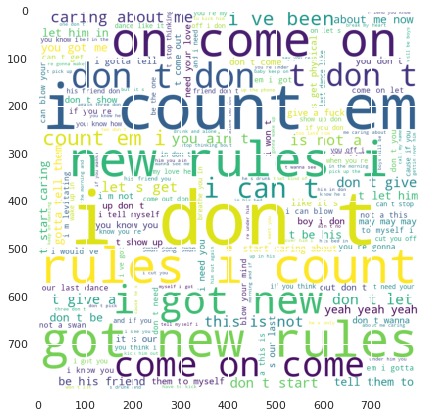


Artist: Billie Eilish


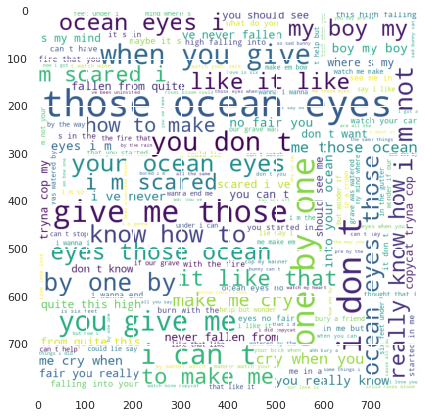


Artist: Lady Gaga


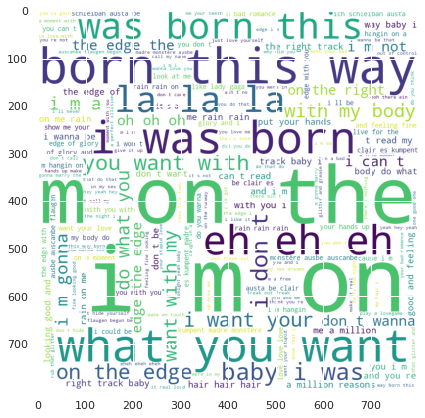


Artist: Rihanna


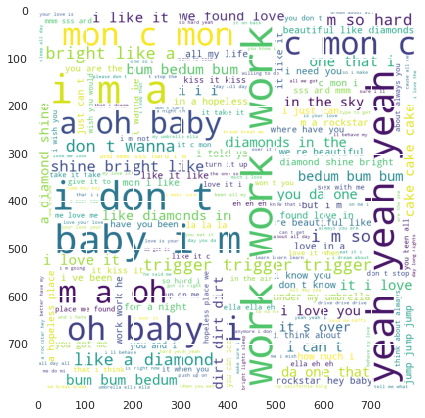

In [ ]:
for row in sf:
  print("Artist: {}".format(row['artists name']))
  draw_artist_word_cloud(row['words_3grams'])
  mp.show()
  print()

#### **A wordcloud comparison of the content of the songs of men versus women**



> First, we deleted all the stopwords


> Next, we found the 500 most common words for both men and women and treated them as "noise" that could be discarded in the data analysis process


In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
import re
nltk.download('stopwords')
from nltk.stem.porter import *
from functools import lru_cache
%matplotlib inline

def draw_entities_word_cloud(d ,entity_type = "PERSON", min_times=100):

    stopwords = set(STOPWORDS) | { 'yeah', 'get' , 'got' ,'cause','oh' , 'one' }

    stopwords_parts = {"sent", "subject", "original message", "unclassified" }
    wordcloud = WordCloud(width = 800, height = 800,
                    background_color ='black',
                    stopwords = stopwords,
                    min_font_size = 10)
    def skip_entity(e):
        if e in stopwords:
            return True
        for p in stopwords_parts:
            if p in e:
                return True
        return False

    # using the subject frquencies
    dct = {k:v for k,v in d.items() if v > min_times and not skip_entity(k)}
    wordcloud.generate_from_frequencies(frequencies=dct)
    plt.figure(figsize = (12, 12), facecolor = None)
    plt.grid(False)
    plt.imshow(wordcloud)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
stemmer = PorterStemmer()

def removestopwordsfromdf(text ):

    stopwords = set(STOPWORDS) | { 'yeah', 'get' , 'got' ,'cause','oh' , 'one' }

    def skip_word(w):
        if len(w) <3 :
            return True
        if w in stopwords or stemmer.stem(w) in stopwords :
            return True

        return False

    re_words = re.compile(r"(\w+)")  #  remove punctutation
    text = re_words.findall(text)
    words = text #word_tokenize(text)
    words = [ w  for w in words  if not skip_word(w)]
    words = " ".join(words)

    return words

def get_most_common_words(txt):
    words = word_tokenize(txt)
    # bigrams = [f"{w1} {w2}" for w1,w2 in zip(words, words[1:])]

    c = Counter(words)
    return c


kaggle_df['Lyric_WithoutStopwords']= kaggle_df['Lyric'].apply(lambda w : removestopwordsfromdf(w))


df_Man= kaggle_df[(kaggle_df['Type']== 'Single - Male')]
txt = "\n".join(df_Man['Lyric_WithoutStopwords'])
c = get_most_common_words(txt)
Top500_Man = c.most_common(500)


df_Woman= kaggle_df[(kaggle_df['Type']== 'Single - Female')]
txt = "\n".join(df_Woman['Lyric_WithoutStopwords'])
c = get_most_common_words(txt)
Top500_Woman = c.most_common(500)


In [ ]:
def removestopwordsfromdf(text ):

    stopwords = set(STOPWORDS) | { 'yeah', 'get' , 'got' ,'cause','oh' , 'one' }
    stopwords_parts = {"sent", "subject", "original message", "unclassified" }

    def skip_word(w):
        if w in InterSectionTop500Common or w in Top500_Man or w in Top500_Woman:
            return True

        return False


    words = word_tokenize(text)
    words = [ w  for w in words  if not skip_word(w)]
    words = " ".join(words)

    return words


Top500_Man_ = [i[0] for i in Top500_Man]
Top500_Woman_ = [i[0] for i in Top500_Woman]
InterSectionTop500Common = list(set(Top500_Man_) & set(Top500_Woman_))
kaggle_df['Lyric_WithoutStopwords_New']= kaggle_df['Lyric_WithoutStopwords'].apply(lambda w : removestopwordsfromdf(w ))

**We can see that the men have more blunt words compared to the women**

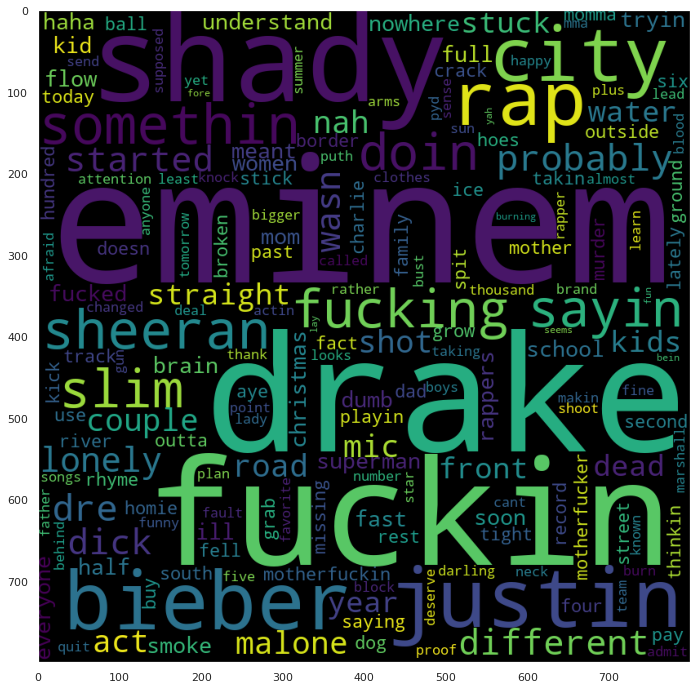

In [ ]:
df_Man= kaggle_df[(kaggle_df['Type']== 'Single - Male')  ]
txt = "\n".join(df_Man['Lyric_WithoutStopwords_New'])
l = [w for w in re.findall(r"(\w+)", txt)]
d_Man = Counter(l)

draw_entities_word_cloud(d_Man)

**In the women we can see more refined words that talk about love and emotion**

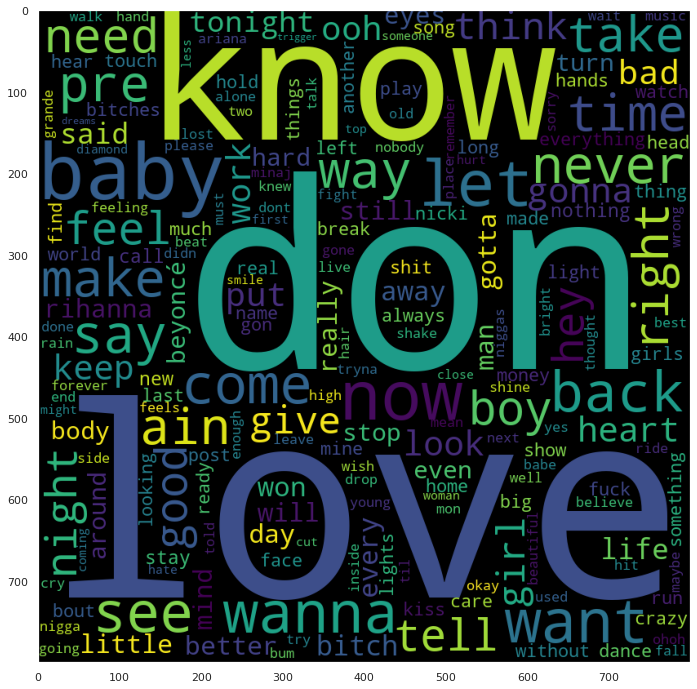

In [ ]:
df_Woman= kaggle_df[(kaggle_df['Type']== 'Single - Female')  ]
txt = "\n".join(df_Woman['Lyric_WithoutStopwords'])
l = [w for w in re.findall(r"(\w+)", txt)]
d_Woman = Counter(l)

draw_entities_word_cloud(d_Woman)

### Identify the song Topics ♬

In this section we separate the lyrics of the male and female performers in order to examine whether there is a substantial change in the topics of the songs and their styles

In [ ]:
from nltk.corpus import stopwords

stop_words_set = set(stopwords.words("english"))

def parse_lyric(lyric):
  res = ""
  lyric_list = lyric.split()
  for word in lyric_list:
    if word in stop_words_set:
      continue
    else:
      res += word + " "

  return res

#### Male 🧑

In [ ]:
from bertopic import BERTopic

male_topic_model = BERTopic(language="multilingual",top_n_words=20, calculate_probabilities=True, verbose=True)

m_kaggle_df = kaggle_df[kaggle_df['Type'] == 'Single - Male']
m_kaggle_df['Lyric'] = m_kaggle_df['Lyric'].apply(lambda x: parse_lyric(str(x)))
male_songs = m_kaggle_df.Lyric.to_list()
male_topics, probs = male_topic_model.fit_transform(male_songs)

Downloading:   0%|          | 0.00/968 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.79k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/645 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/471M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/239 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/9.08M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/480 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/14.8M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

Batches:   0%|          | 0/42 [00:00<?, ?it/s]

2022-08-21 07:46:11,961 - BERTopic - Transformed documents to Embeddings
2022-08-21 07:46:25,106 - BERTopic - Reduced dimensionality
2022-08-21 07:46:25,202 - BERTopic - Clustered reduced embeddings


In [ ]:
male_topic_model.visualize_barchart(top_n_topics=25)

In [ ]:
male_topic_model.visualize_hierarchy(top_n_topics=50)

In [ ]:
male_topic_model.visualize_heatmap(n_clusters=1, width=500, height=500)

In [ ]:
timestamps = m_kaggle_df.Year.to_list()
male_topics_over_time = male_topic_model.topics_over_time(male_songs, male_topics, timestamps, nr_bins=20)
male_topic_model.visualize_topics_over_time(male_topics_over_time, top_n_topics=26)

19it [00:01, 13.40it/s]


#### Female 👩

In [ ]:
!pip3 install --upgrade tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 511.7 MB 6.5 kB/s 
     |████████████████████████████████| 438 kB 67.7 MB/s 
     |████████████████████████████████| 1.6 MB 56.1 MB/s 
     |████████████████████████████████| 5.8 MB 44.4 MB/s 
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.0.1
    Uninstalling tensorflow-estimator-2.0.1:
      Successfully uninstalled tensorflow-estimator-2.0.1
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.8.0
    Uninstalling tensorboard-2.8.0:
      Successfully uninstalled tensorboard-2.8.0
  Attempting uninstall: keras
    Found existing installation: keras 2.8.0
    Uninstalling keras-2.8.0:
      Successfully uninstalled keras-2.8.0
  Attempting uninstall: flatbuffers
    Found existing installation: flatbuffers 2.0
    Uninstalling flatbuffers-2.0:
      Successfully un

In [ ]:
from bertopic import BERTopic

female_topic_model = BERTopic(language="multilingual",top_n_words=20, calculate_probabilities=True, verbose=True)

f_kaggle_df = kaggle_df[kaggle_df['Type'] == 'Single - Female']
f_kaggle_df['Lyric'] = f_kaggle_df['Lyric'].apply(lambda x: parse_lyric(str(x)))
female_songs = f_kaggle_df.Lyric.to_list()
female_topics, probs = female_topic_model.fit_transform(female_songs)

Batches:   0%|          | 0/72 [00:00<?, ?it/s]

2022-08-21 07:47:31,186 - BERTopic - Transformed documents to Embeddings
2022-08-21 07:47:57,389 - BERTopic - Reduced dimensionality
2022-08-21 07:47:58,141 - BERTopic - Clustered reduced embeddings


In [ ]:
female_topic_model.visualize_barchart(top_n_topics=25)

In [ ]:
female_topic_model.visualize_hierarchy(top_n_topics=50)

In [ ]:
female_topic_model.visualize_heatmap(n_clusters=20, width=800, height=800)

In [ ]:
timestamps = f_kaggle_df.Year.to_list()
female_topics_over_time = female_topic_model.topics_over_time(female_songs, female_topics, timestamps, nr_bins=20)
female_topic_model.visualize_topics_over_time(female_topics_over_time, top_n_topics=26)

13it [00:01,  9.98it/s]


## Pictures dataset

In [ ]:
# ################################################################################
# #######################    Extract Pictures from Twitter    ####################
# ################################################################################

# ##  Introduction:
# ##  We wanted to extract an advanced feature like images from Twitter
# ##  We used snscrape of the version of the developers from the git
# ##  and it requires colab 3.8
# ##  Therefore the code below updates the colab to 3.8 version
# ##  and then the user needs restart the runtime
# ##  After updating the version of the colab, we noticed that
# ##  the colab becomes slow and cannot be run anymore
# ##  So we ran the crawl once and then saved the results in the cloud.
# ##  Finally we reverted the colab back to version 3.7 and continue to work

# ################################################################################


# ################################################################################
# ################################    Steps    ###################################
# ################################################################################

# ################################################################################
# #######################   1. Installing 3.8 version for colab    ###############
# ################################################################################

# import sys;

# !wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py38_4.8.2-Linux-x86_64.sh
# !chmod +x mini.sh
# !bash ./mini.sh -b -f -p /usr/local
# !conda install -q -y jupyter
# !conda install -q -y google-colab -c conda-forge
# !python -m ipykernel install --name "py38" --user


# !pip3 install snscrape
# !sudo apt-get update -y
# !sudo apt-get install python3.8
# !sudo update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.7 1
# from IPython.display import clear_output
# clear_output()
# !sudo update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.8 2
# !sudo apt-get install python3-pip
# !sudo apt install python3.8-distutils
# !python3 -m pip install --upgrade pip
# !pip3 install git+https://github.com/JustAnotherArchivist/snscrape.git



# ################################################################################
# ##############   2. Check if version of colab updated to 3.8    ################
# ################################################################################

# print(sys.version)
# !python --version
# !python3 --version



# ################################################################################
# ########  3. Crawling the pictures from Twitter and create dataset    ##########
# ################################################################################

# import snscrape.modules.twitter as sntwitter
# import time
# import pandas as pd
# import os
# from datetime import date
# singers=['rihanna', 'edsheeran','katyperry', 'justinbieber' ]
# ManUtd_list = []
# for sing in singers:
#   for i,tweet in enumerate(sntwitter.TwitterSearchScraper('from:{}'.format(sing)).get_items()):
#       if i>10000: #number of tweets you want to scrape
#           break
#       ManUtd_list.append([tweet.date, tweet.id,  tweet.content ,sing,  tweet.media ]) #declare the attributes to be returned

#   # # Creating a dataframe from the tweets list above
#   ManUtd_df = pd.DataFrame(ManUtd_list, columns=['Datetime', 'Tweet Id', 'Text','Singer','Media' ])


# ManUtd_df.to_csv('Singers_Images.txt')
# ManUtd_df.head()

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python3-pip is already the newest version (9.0.1-2.3~ubuntu1.18.04.5).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 25 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
Note, selecting 'python3-distutils' instead of 'python3.8-distutils'
python3-distutils is already the newest version (3.6.9-1~18.04).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 25 not upgraded.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simpl

/tmp/ipykernel_5523/2334599743.py:71: FutureWarning: content is deprecated, use rawContent instead
  ManUtd_list.append([tweet.date, tweet.id,  tweet.content ,sing,  tweet.media ]) #declare the attributes to be returned


,Datetime,Tweet Id,Text,Singer,Media
0,2022-05-10 16:32:14+00:00,1524064780708835329,i’ve been waiting for this moment!! @fentybeau...,rihanna,[Photo(previewUrl='https://pbs.twimg.com/media...
1,2022-05-07 21:32:20+00:00,1523053141142360065,and that’s on self care bih 🧖🏿‍♀️ https://t.co...,rihanna,[Video(thumbnailUrl='https://pbs.twimg.com/ext...
2,2022-05-03 06:12:57+00:00,1521372218617335809,shut down the met in marble! what’s more gilde...,rihanna,[Video(thumbnailUrl='https://pbs.twimg.com/ext...
3,2022-05-02 01:33:01+00:00,1520939382697459713,how sexy is this?!! 🤎 #FENTYPARFUM https://t.c...,rihanna,[Video(thumbnailUrl='https://pbs.twimg.com/ext...
4,2022-05-01 15:55:52+00:00,1520794141277401088,wake up and smell the billboard NYC!!!! \n\na ...,rihanna,[Photo(previewUrl='https://pbs.twimg.com/media...


Load from Cloud the dataset

In [ ]:
import pandas as pd

!mkdir ./datasets
!wget -O ./datasets/Singers_Images.txt https://res.cloudinary.com/dfgjujaok/raw/upload/v1661088865/Singers_Images_sm0ugl.txt

df = pd.read_csv('/content/datasets/Singers_Images.txt')
df_nona = df.dropna()
df_nona.shape

--2022-08-21 18:24:51--  https://res.cloudinary.com/dfgjujaok/raw/upload/v1661088865/Singers_Images_sm0ugl.txt
Resolving res.cloudinary.com (res.cloudinary.com)... 151.101.1.137, 151.101.65.137, 151.101.129.137, ...
Connecting to res.cloudinary.com (res.cloudinary.com)|151.101.1.137|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7370036 (7.0M) [text/plain]
Saving to: ‘./datasets/Singers_Images.txt’

./datasets/Singers_ 100%[===================>]   7.03M  22.4MB/s    in 0.3s    

2022-08-21 18:24:52 (22.4 MB/s) - ‘./datasets/Singers_Images.txt’ saved [7370036/7370036]



(4824, 6)

Extract the links of the images in seperate column

In [ ]:
from json import loads
from ast import literal_eval
import re

def ExtractImages (media):

    links=[]
    text = media
    pics = re.findall('fullUrl=(.+?)[,)]', text)
    vids= re.findall('thumbnailUrl=(.+?)[,)]', text)
    links+=pics
    links+= vids
    return links


df_nona['links'] = df_nona['Media'].apply( lambda imgs : ExtractImages(imgs))
df_expd= df_nona.explode('links')
d = df_expd.drop_duplicates( keep="first")[['Tweet Id','Datetime','Text','Singer'	,'links']]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


Extract the emotion from the images by Deepface library

In [ ]:
from traitlets.traitlets import link
import cv2
from deepface import DeepFace
import numpy as np

def RecogenizeEmotion (url):

   try:
    analyze = DeepFace.analyze(img_path =url.replace("'",""), actions =['emotion'], enforce_detection = False)  #here the first parameter is the image we want to analyze #the second one there is the action

    return analyze['dominant_emotion']

   except:
    return None


d['Emotion'] = d['links'].apply( lambda link : RecogenizeEmotion(link))
d.head()

Directory  /root /.deepface created
Directory  /root /.deepface/weights created
facial_expression_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facial_expression_model_weights.h5
To: /root/.deepface/weights/facial_expression_model_weights.h5
100%|██████████| 5.98M/5.98M [00:00<00:00, 75.3MB/s]


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


,Tweet Id,Datetime,Text,Singer,links,Emotion
0,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,'https://pbs.twimg.com/media/FSaQ1ThUcAAqz5k?f...,neutral
0,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,'https://pbs.twimg.com/media/FSaQ1TeVgAAvnlI?f...,happy
0,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,'https://pbs.twimg.com/media/FSaQ1TfVcAExyss?f...,sad
0,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,'https://pbs.twimg.com/media/FSaQ1TfVIAM2Fju?f...,happy
1,1523053141142360065,2022-05-07 21:32:20+00:00,and that’s on self care bih 🧖🏿‍♀️ https://t.co...,rihanna,'https://pbs.twimg.com/ext_tw_video_thumb/1523...,happy


Now we will explore the images and the emotions that we extracted earlier

In [ ]:
import pandas as pd

d = pd.read_csv('finalds_withemotions.txt')
df_Pictures = d[['Tweet Id','Datetime','links','Singer','Emotion']] # 'Text',
df_Pictures['Year'] = pd.to_datetime(df_Pictures['Datetime']).dt.year

df_Pictures = df_Pictures.dropna()
df_Pictures = df_Pictures[df_Pictures['Emotion']!= 'neutral']#['Emotion'].unique()
df_Pictures.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,Tweet Id,Datetime,links,Singer,Emotion,Year
1,1524064780708835329,2022-05-10 16:32:14+00:00,'https://pbs.twimg.com/media/FSaQ1TeVgAAvnlI?f...,rihanna,happy,2022
2,1524064780708835329,2022-05-10 16:32:14+00:00,'https://pbs.twimg.com/media/FSaQ1TfVcAExyss?f...,rihanna,sad,2022
3,1524064780708835329,2022-05-10 16:32:14+00:00,'https://pbs.twimg.com/media/FSaQ1TfVIAM2Fju?f...,rihanna,happy,2022
4,1523053141142360065,2022-05-07 21:32:20+00:00,'https://pbs.twimg.com/ext_tw_video_thumb/1523...,rihanna,happy,2022
5,1521372218617335809,2022-05-03 06:12:57+00:00,'https://pbs.twimg.com/ext_tw_video_thumb/1521...,rihanna,surprise,2022


Frequency of each Emotion.
It's can be seems that happy and sad are pretty equal.

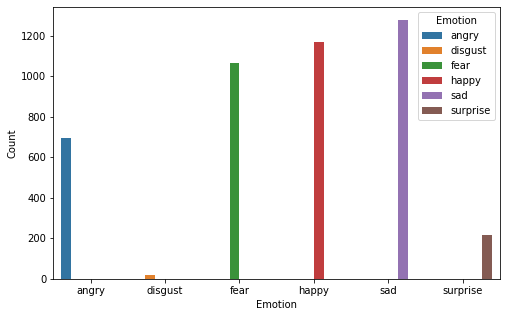

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

df3 = df_Pictures.loc[:,[ 'Emotion']].groupby([ 'Emotion'])['Emotion'].agg('count').rename('Count' ).reset_index()

plt.gcf().set_size_inches(8, 5)
sns.barplot(x='Emotion',  y="Count",  data=df3 , hue= 'Emotion')

Distribution of emotions per singers.

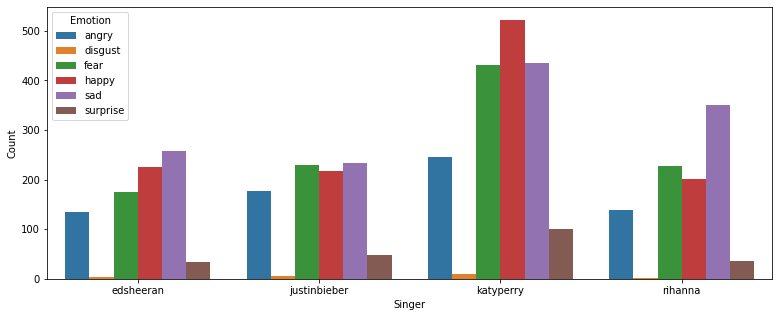

In [ ]:
df3 = df_Pictures.loc[:,['Singer','Emotion']].groupby([ 'Singer','Emotion'])['Emotion'].agg('count').rename('Count' ).reset_index()

plt.gcf().set_size_inches(13, 5)
sns.barplot(x='Singer',  y="Count",  data=df3 , hue= 'Emotion')

Pictures Insights

In [ ]:
import os
import re

!mkdir ./pictures2/


for url in df_Pictures['links']:
  # !wget -O ./pictures2/{os.path.basename(os.path.normpath(url.strip()))}  {url.strip()}
  !wget -O ./pictures2/{re.findall('media/(.+?)[?]', url.strip())[0]+'.'+re.findall('format=(.+?)[&]', url.strip())[0]}  {url.strip()}


Streaming output truncated to the last 5000 lines.
HTTP request sent, awaiting response... 200 OK
Length: 35603 (35K) [image/jpeg]
Saving to: ‘./pictures2/Cdg52IbWIAAKDW-.jpg’

./pictures2/Cdg52Ib 100%[===================>]  34.77K  --.-KB/s    in 0s      

2022-08-21 19:51:47 (144 MB/s) - ‘./pictures2/Cdg52IbWIAAKDW-.jpg’ saved [35603/35603]

--2022-08-21 19:51:47--  https://pbs.twimg.com/media/Cdg52UpWwAEhKI5?format=jpg&name=large
Resolving pbs.twimg.com (pbs.twimg.com)... 72.21.91.70, 2606:2800:220:1410:489:141e:20bb:12f6
Connecting to pbs.twimg.com (pbs.twimg.com)|72.21.91.70|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 50688 (50K) [image/jpeg]
Saving to: ‘./pictures2/Cdg52UpWwAEhKI5.jpg’

./pictures2/Cdg52Up 100%[===================>]  49.50K  --.-KB/s    in 0.007s  

2022-08-21 19:51:47 (7.37 MB/s) - ‘./pictures2/Cdg52UpWwAEhKI5.jpg’ saved [50688/50688]

--2022-08-21 19:51:48--  https://pbs.twimg.com/media/CdbOgufWoAE1j62?format=jpg&name=large
Resolvi

In [ ]:
import turicreate as tc


sf = tc.image_analysis.load_images('./pictures2/' , with_path=True )
sf

In [ ]:
def ExtractId(path):

  try :
      return re.findall('media/(.+?)[?]', path.strip())[0]
  except:
    return None

df_Pictures['picture_id'] = df_Pictures['links'].apply(lambda p: ExtractId(p) )
sf['picture_id']=sf['path'].apply(lambda p: os.path.basename(os.path.normpath(p[:-4].strip())) )
sf_df= tc.SFrame(df_Pictures[['picture_id','Emotion','Singer','Year']].dropna())
sf_unioned=sf.join(sf_df, on={'picture_id':'picture_id'}, how='inner')

,path,image,picture_id,Emotion,Singer,Year
0,/content/pictures2/FSaQ1TeVgAAvnlI.jpg,,FSaQ1TeVgAAvnlI,happy,rihanna,2022
1,/content/pictures2/FSaQ1TfVcAExyss.jpg,,FSaQ1TfVcAExyss,sad,rihanna,2022
2,/content/pictures2/FSaQ1TfVIAM2Fju.jpg,,FSaQ1TfVIAM2Fju,happy,rihanna,2022
3,/content/pictures2/FRryNPxVEAAxU_v.jpg,,FRryNPxVEAAxU_v,sad,rihanna,2022
4,/content/pictures2/FRryNPuUYAAyeWr.jpg,,FRryNPuUYAAyeWr,fear,rihanna,2022
5,/content/pictures2/FRfA6jjUYAAaTH8.jpg,,FRfA6jjUYAAaTH8,fear,rihanna,2022
6,/content/pictures2/FRfA6kOVIAIFrm2.jpg,,FRfA6kOVIAIFrm2,fear,rihanna,2022
7,/content/pictures2/FRfA6mMVsAAb0Mk.jpg,,FRfA6mMVsAAb0Mk,fear,rihanna,2022
8,/content/pictures2/FRfA55yUYAA-1eV.jpg,,FRfA55yUYAA-1eV,sad,rihanna,2022
9,/content/pictures2/FRfA56eVcAAh2NR.jpg,,FRfA56eVcAAh2NR,fear,rihanna,2022

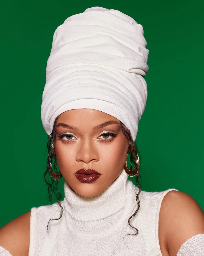
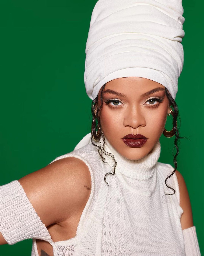
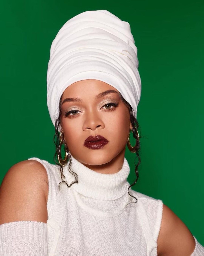
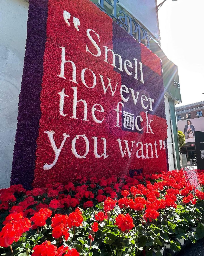
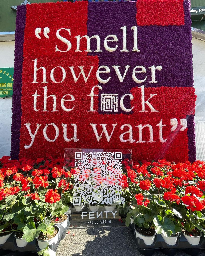
...
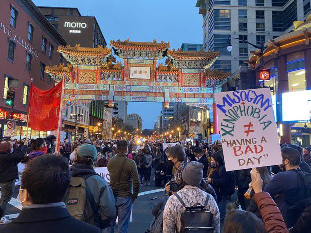
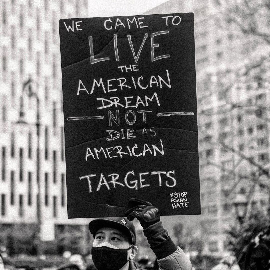
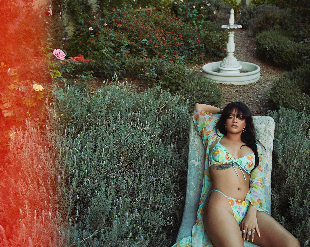
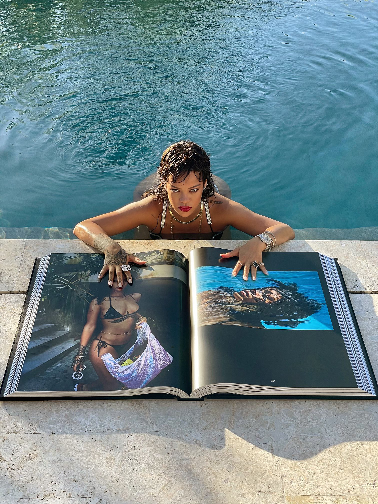
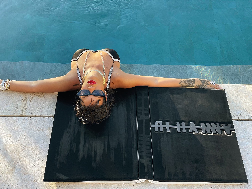

In [ ]:
sf_unioned.explore()

In [ ]:
def get_images_features_vector(dataset, target, feature="image", model_name='resnet-50'):
    #ptModel = _pre_trained_models.MODELS[model_name]()
    ptModel = tc.toolkits._pre_trained_models.ResNetImageClassifier()
    feature_extractor = tc.toolkits._image_feature_extractor._create_feature_extractor("resnet-50")
    extracted_features = tc.SFrame({
        # target: dataset[target],
        '__image_features__': feature_extractor.extract_features(dataset, feature),
        })
    dataset['image_features'] = extracted_features['__image_features__']
    return dataset

sf_unioned = get_images_features_vector(sf_unioned, 'name')

Download completed: /var/tmp/model_cache/resnet-50-TuriCreate-6.0.h5
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Computed X:  (3062, 2048)
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 3062 samples in 0.005s...
[t-SNE] Computed neighbors for 3062 samples in 1.077s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3062
[t-SNE] Computed conditional probabilities for sample 2000 / 3062
[t-SNE] Computed conditional probabilities for sample 3000 / 3062
[t-SNE] Computed conditional probabilities for sample 3062 / 3062
[t-SNE] Mean sigma: 6.052156
[t-SNE] Computed conditional probabilities in 0.855s
[t-SNE] Iteration 50: error = 61.9825897, gradient norm = 0.0481262 (50 iterations in 4.300s)
[t-SNE] Iteration 100: error = 62.2037659, gradient norm = 0.0518013 (50 iterations in 3.993s)
[t-SNE] Iteration 150: error = 62.1635818, gradient norm = 0.0699077 (50 iterations in 3.768s)
[t-SNE] Iteration 200: error = 61.9991760, gradient norm = 0.0671663 (50 iterations in 4.519s)
[t-SNE] Iteration 250: error = 62.1417542, gradient norm = 0.0804900 (50 iterations in 5.541s)
[t-SNE] KL d

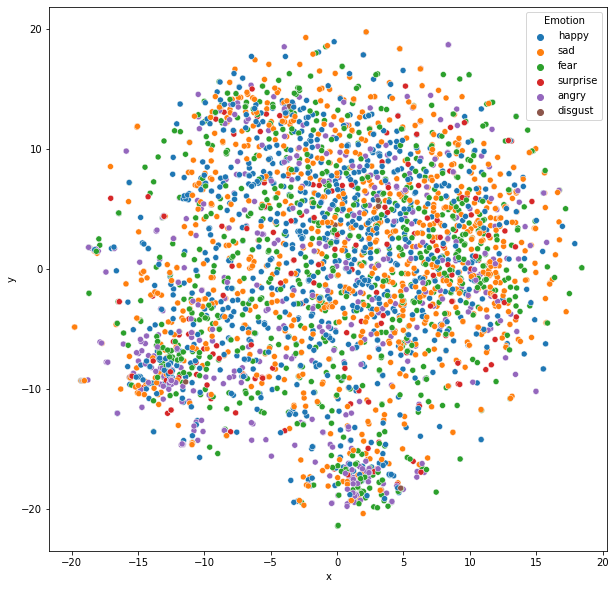

In [ ]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

X = []
for v in sf_unioned['image_features']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2,perplexity=150, n_iter=5000, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)

df = pd.DataFrame(columns=['x', 'y', 'Emotion'])
df['x'], df['y'], df['Emotion'] = X_embedded[:,0], X_embedded[:,1], sf_unioned['Emotion']


plt.figure(figsize=(10,10))
sns.scatterplot(x="x", y="y", hue="Emotion", data=df)

Computed X:  (3062, 2048)
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 3062 samples in 0.006s...
[t-SNE] Computed neighbors for 3062 samples in 0.999s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3062
[t-SNE] Computed conditional probabilities for sample 2000 / 3062
[t-SNE] Computed conditional probabilities for sample 3000 / 3062
[t-SNE] Computed conditional probabilities for sample 3062 / 3062
[t-SNE] Mean sigma: 6.052156
[t-SNE] Computed conditional probabilities in 0.812s
[t-SNE] Iteration 50: error = 61.7995148, gradient norm = 0.0660418 (50 iterations in 3.361s)
[t-SNE] Iteration 100: error = 61.7940063, gradient norm = 0.0662676 (50 iterations in 3.347s)
[t-SNE] Iteration 150: error = 61.9890327, gradient norm = 0.0627460 (50 iterations in 3.870s)
[t-SNE] Iteration 200: error = 61.8505135, gradient norm = 0.0592178 (50 iterations in 3.399s)
[t-SNE] Iteration 250: error = 61.7835999, gradient norm = 0.0545677 (50 iterations in 3.668s)
[t-SNE] KL d

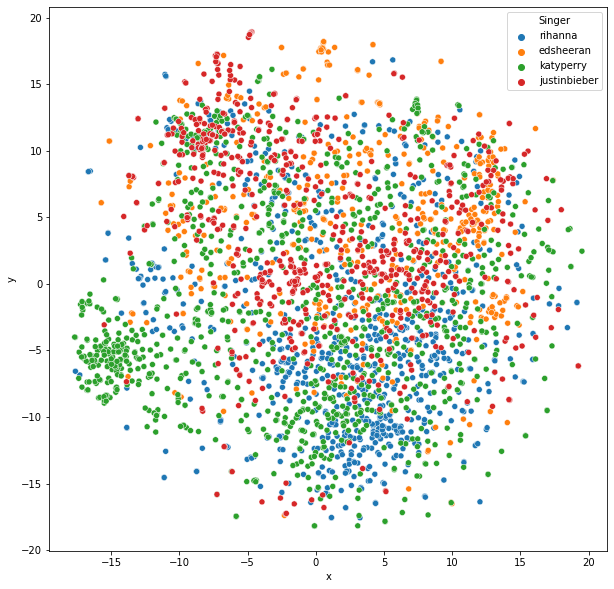

In [ ]:
X = []
for v in sf_unioned['image_features']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2,perplexity=150, n_iter=5000, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)

df = pd.DataFrame(columns=['x', 'y', 'Singer'])
df['x'], df['y'], df['Singer'] = X_embedded[:,0], X_embedded[:,1], sf_unioned['Singer']


plt.figure(figsize=(10,10))
sns.scatterplot(x="x", y="y", hue="Singer", data=df)

Find the Classified Sentiment score  of each singer per year

In [ ]:
def Sentiment(sent):
  if sent in ['surprise', 'happy']:
    return 1
  else:
     return -1

df3 = df_Pictures.loc[:,['Singer','Year','Emotion']].groupby(['Singer','Year','Emotion'])['Emotion'].agg('count').rename('Count' ).reset_index()
df3 = df3[df3['Emotion'].isin(['surprise', 'happy', 'sad'])]
df3['Sentiment'] = df3['Emotion'].apply(lambda sent : Sentiment(sent) )
df3 = df3.loc[:,['Singer','Year','Sentiment','Count']].groupby(['Singer','Year','Sentiment'])['Count'].agg('sum').rename('Sum' ).reset_index()
df4 = df3.loc[:,['Singer','Year','Sum']].groupby(['Singer','Year'])['Sum'].agg('max').rename('Max' ).reset_index()


df_Pictures_Grouped= df4.merge(df3, left_on=['Singer','Year','Max'] , right_on=['Singer','Year','Sum' ] )
df_Pictures_Grouped

,Singer,Year,Max,Sentiment,Sum
0,edsheeran,2021,162,1,162
1,edsheeran,2022,101,-1,101
2,justinbieber,2012,1,1,1
3,justinbieber,2013,29,1,29
4,justinbieber,2014,22,-1,22
5,justinbieber,2015,73,1,73
6,justinbieber,2016,34,1,34
7,justinbieber,2017,7,-1,7
8,justinbieber,2018,3,1,3
9,justinbieber,2019,9,1,9


## Tweetes DataSet

In [ ]:
from afinn import Afinn
import pandas as pd

afinn = Afinn(emoticons=True)

df_Tweets = d[['Tweet Id','Datetime','Text','Singer','Emotion']].drop_duplicates()
df_Tweets['Year'] = pd.to_datetime(df_Tweets['Datetime']).dt.year

df_Tweets = df_Tweets.dropna()
df_Tweets = df_Tweets[df_Tweets['Emotion']!= 'neutral']
df_Tweets['Affin Score'] = df_Tweets['Text'].apply(lambda x: afinn.score(x))
df_Tweets['LengthOfTxt'] = df_Tweets['Text'].apply(lambda l : len(l))
df_Tweets = df_Tweets.reset_index(drop=True)
df_Tweets.head()

,Tweet Id,Datetime,Text,Singer,Emotion,Year,Affin Score,LengthOfTxt
0,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,happy,2022,0.0,269
1,1524064780708835329,2022-05-10 16:32:14+00:00,i’ve been waiting for this moment!! @fentybeau...,rihanna,sad,2022,0.0,269
2,1523053141142360065,2022-05-07 21:32:20+00:00,and that’s on self care bih 🧖🏿‍♀️ https://t.co...,rihanna,happy,2022,2.0,57
3,1521372218617335809,2022-05-03 06:12:57+00:00,shut down the met in marble! what’s more gilde...,rihanna,surprise,2022,4.0,178
4,1520939382697459713,2022-05-02 01:33:01+00:00,how sexy is this?!! 🤎 #FENTYPARFUM https://t.c...,rihanna,happy,2022,3.0,82


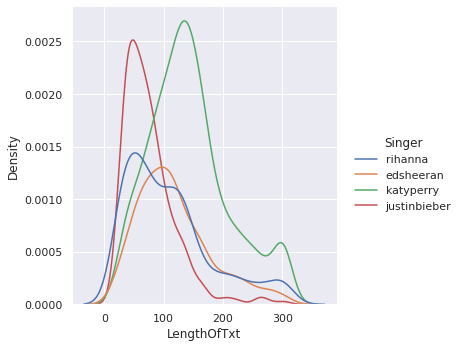

In [ ]:
import seaborn as sns
%matplotlib inline
sns.set()


dfplot = df_Tweets[['Singer','LengthOfTxt']]
sns.displot(data=dfplot, x="LengthOfTxt" ,  kind="kde" , hue = 'Singer' )

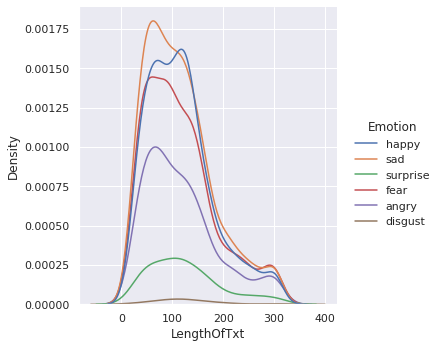

In [ ]:
dfplot = df_Tweets[['Emotion','LengthOfTxt']]

sns.displot(data=dfplot, x="LengthOfTxt" ,  kind="kde" , hue = 'Emotion' )

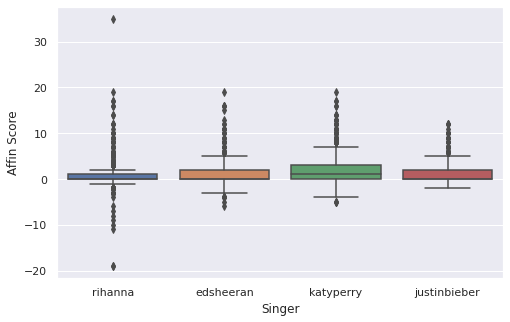

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
ax = sns.boxplot(x="Singer", y="Affin Score", data=df_Tweets)

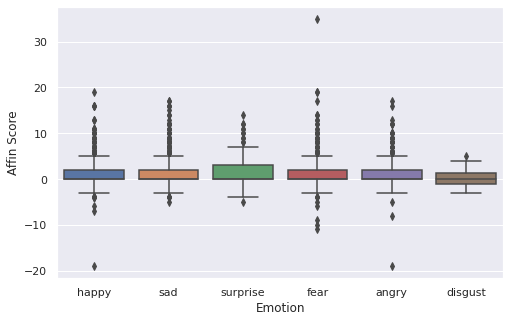

In [ ]:
plt.figure(figsize=(8, 5))

ax = sns.boxplot(x="Emotion", y="Affin Score", data=df_Tweets)

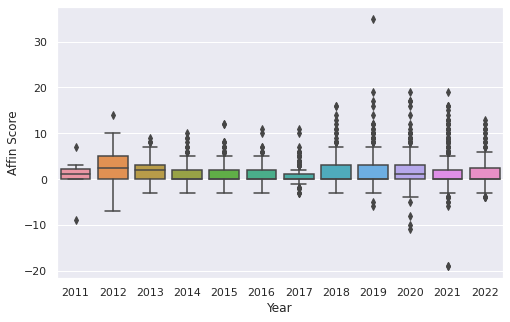

In [ ]:
plt.figure(figsize=(8, 5))
ax = sns.boxplot(x="Year", y="Affin Score", data=df_Tweets)

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
import re
nltk.download('stopwords')
from nltk.stem.porter import *
from functools import lru_cache
%matplotlib inline

stemmer = PorterStemmer()

def removestopwordsfromdf(text ):

    stopwords = set(STOPWORDS) | { 'yeah', 'get' , 'got' ,'cause','oh' , 'one' }

    def skip_word(w):
        if len(w) <3 :
            return True
        if w in stopwords or stemmer.stem(w) in stopwords :
            return True

        return False

    text = re.sub(r'https?://\S+', '',text)
    re_words = re.compile(r"(\w+)")  #  remove punctutation
    text = re_words.findall(text)
    words = text #word_tokenize(text)
    words = [ w  for w in words  if not skip_word(w)]
    words = " ".join(words)

    return words

def get_most_common_words(txt):
    words = word_tokenize(txt)

    c = Counter(words)
    return c

df_Tweets['Text_WithoutStopwords']= df_Tweets['Text'].apply(lambda w : removestopwordsfromdf(w))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
def removestopwordsfromdf(text ):

    stopwords = set(STOPWORDS) | { 'yeah', 'get' , 'got' ,'cause','oh' , 'one' }
    stopwords_parts = {"sent", "subject", "original message", "unclassified" }

    def skip_word(w):

        if w in InterSectionTop500Common or w in Top500_Happy_ or w in Top500_Sad_:
            return True

        return False

    words = word_tokenize(text)
    words = [ w  for w in words  if not skip_word(w)]
    words = " ".join(words)

    return words


df_Happy= df_Tweets[(df_Tweets['Emotion']== 'happy')]
txt = "\n".join(df_Happy['Text_WithoutStopwords'])
c = get_most_common_words(txt)
Top500_Happy = c.most_common(500)


df_Sad= df_Tweets[(df_Tweets['Emotion']== 'sad')]
txt = "\n".join(df_Sad['Text_WithoutStopwords'])
c = get_most_common_words(txt)
Top500Sad = c.most_common(500)


Top500_Happy_ = [i[0] for i in Top500_Happy]
Top500_Sad_ = [i[0] for i in Top500Sad]
InterSectionTop500Common = list(set(Top500_Happy_) & set(Top500_Sad_))


df_Tweets['Text_WithoutStopwords_New']= df_Tweets['Text_WithoutStopwords'].apply(lambda w : removestopwordsfromdf(w ))

In [ ]:
import gensim
import gzip
import gensim
from gensim.models import Word2Vec, KeyedVectors
from sklearn.decomposition import PCA


################################################################################
##############     Downloading the GoogleNews pretrained mode     ##############
################################################################################

!gdown 0B7XkCwpI5KDYNlNUTTlSS21pQmM # https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit?resourcekey=0-wjGZdNAUop6WykTtMip30g
!gunzip './GoogleNews-vectors-negative300.bin'

model = gensim.models.KeyedVectors.load_word2vec_format('./GoogleNews-vectors-negative300.bin', binary=True)


################################################################################
#########################          Alternative           #######################
################################################################################

# !wget -c "https://figshare.com/ndownloader/files/10798046"
# model = gensim.models.KeyedVectors.load_word2vec_format('/content/10798046', binary=True)

Downloading...
From: https://drive.google.com/uc?id=0B7XkCwpI5KDYNlNUTTlSS21pQmM
To: /content/GoogleNews-vectors-negative300.bin.gz
100% 1.65G/1.65G [00:12<00:00, 136MB/s]


In [ ]:
import nltk
from nltk.tokenize import word_tokenize
import numpy as np
from tqdm import tqdm
import spacy

nltk.download('punkt')

def txt2vector(txt):
    words = word_tokenize(txt)
    words = [w for w in words if w in model]
    words= list(set(words))
    if len(words) != 0:
        return np.mean([model[w] for w in words], axis=0)
    return None

df_Tweets['w2v_gensim'] = df_Tweets['Text_WithoutStopwords_New'].apply(lambda x: np.array(txt2vector(x), dtype=float))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Computed X:  (1754, 300)
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1754 samples in 0.001s...
[t-SNE] Computed neighbors for 1754 samples in 0.147s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1754
[t-SNE] Computed conditional probabilities for sample 1754 / 1754
[t-SNE] Mean sigma: 0.502064
[t-SNE] Computed conditional probabilities in 0.083s
[t-SNE] Iteration 50: error = 100.1773071, gradient norm = 0.2741622 (50 iterations in 1.867s)
[t-SNE] Iteration 100: error = 104.1237488, gradient norm = 0.2111612 (50 iterations in 2.021s)
[t-SNE] Iteration 150: error = 105.5092087, gradient norm = 0.1942676 (50 iterations in 1.096s)
[t-SNE] Iteration 200: error = 108.3045044, gradient norm = 0.1765474 (50 iterations in 1.063s)
[t-SNE] Iteration 250: error = 105.6709671, gradient norm = 0.1782839 (50 iterations in 1.141s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 105.670967
[t-SNE] KL divergence after 251 iterations: 179769313486231570

(-1.0, 1.0)

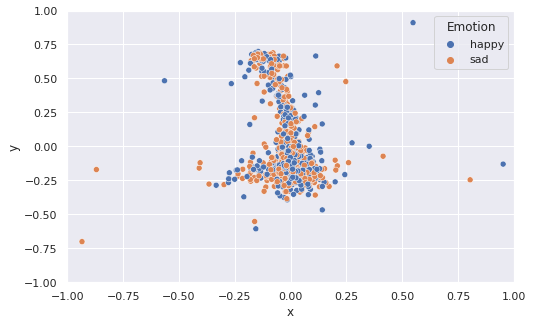

In [ ]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

df_filtered= df_Tweets.dropna()
df_filtered= df_filtered[df_filtered['Emotion'].isin(['happy','sad'])]


X = []
for v in df_filtered['w2v_gensim']:
    X.append(v)
X = np.array(X)

print("Computed X: ", X.shape)


X_embedded = TSNE(n_components=2, n_iter=250, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)


df_tsne = pd.DataFrame(columns=['x', 'y'])
df_tsne['x'], df_tsne['y'] = X_embedded[:,0], X_embedded[:,1]
df_tsne['Emotion']= df_filtered['Emotion'].values


df_tsne['Emotion'] = df_tsne['Emotion'].astype(str)

plt.figure(figsize=(8,5))
sns.scatterplot(x="x", y="y", hue="Emotion", data=df_tsne)

plt.xlim(-1,1)
plt.ylim(-1,1)

In [ ]:
threshold_sent = 50

def Sentiment(sent):
  if sent > threshold_sent:
    return 1
  else:
     return -1

df_Tweets_Grouped = df_Tweets.loc[:,['Singer','Year','Affin Score']].groupby(['Singer','Year'])['Affin Score'].agg('sum').rename('Sum' ).reset_index()
df_Tweets_Grouped['Sentiment'] = df_Tweets_Grouped['Sum'].apply(lambda sent : Sentiment(sent) )
df_Tweets_Grouped

,Singer,Year,Sum,Sentiment
0,edsheeran,2021,568.0,1
1,edsheeran,2022,333.0,1
2,justinbieber,2012,12.0,-1
3,justinbieber,2013,112.0,1
4,justinbieber,2014,102.0,1
5,justinbieber,2015,331.0,1
6,justinbieber,2016,102.0,1
7,justinbieber,2017,21.0,-1
8,justinbieber,2018,5.0,-1
9,justinbieber,2019,41.0,-1


# Examining the information culture of singers in relation to life events 🧑‍🎤

---
**The purpose of our research is to try to find a correlation between the life events that a certain singer went through, and the information culture he represents and shares with the world**

We will make a comparison for each singer between his life events in relation to three different sources of information:


1️⃣    The singer's lyrics

2️⃣    The pictures of the singer

3️⃣    The tweets he uploads on social networks




## 1️⃣ - Songs comparison


---
**In this section we will present an analysis dealing with a comparison for each singer - is there a match between the events of the singer's life described in the blog about him, and the content of his songs in those years.**
The intersection points in the graphs represent a match between the life event described for the singer for a certain year and the content of the songs he released in that year


In [ ]:
from afinn import Afinn

afinn = Afinn(emoticons=True)
options = ['Rihanna','Beyoncé','Katy Perry','Eminem','Ed Sheeran','Justin Bieber']
singers_df = kaggle_df.loc[kaggle_df['Artist'].isin(options)]
singers_df.dropna( inplace=True)
singers_df = singers_df[['Artist','Year','Lyric','Type']]
singers_df['Year'] = singers_df['Year'].apply(lambda x: int(x))
singers_df['Affin Score'] = singers_df['Lyric'].apply(lambda x: afinn.score(x))

singers_df

,Artist,Year,Lyric,Type,Affin Score
308,Beyoncé,2013,beyoncé i've been drinkin' i've been drinkin' ...,Single - Female,37.0
309,Beyoncé,2016,messy mya what happened at the new wil'ins bit...,Single - Female,-35.0
310,Beyoncé,2013,part yoncé let me hear you say hey ms carte...,Single - Female,77.0
311,Beyoncé,2013,beyoncé i've been watching for the signs took ...,Single - Female,39.0
312,Beyoncé,2016,hold up they don't love you like i love you sl...,Single - Female,179.0
...,...,...,...,...,...
4388,Rihanna,2009,and you can see my heart beating you can see i...,Single - Female,-17.0
4389,Rihanna,2009,take a breath take it deep calm yourself he sa...,Single - Female,-18.0
4390,Rihanna,2011,rihanna feels so good being bad ohohohohoh the...,Single - Female,138.0
4391,Rihanna,2020,fox i was good on my own that's the way it w...,Single - Female,-44.0


### 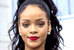 Rihanna

In [ ]:
import matplotlib.pyplot as plt

Rihanna_blog_df = blogs_result[blogs_result['Singer'] == 'Rihanna' ]
Rihanna_blog_df = Rihanna_blog_df.sort_values(by=['Year'])

Rihanna_kaggle_df = singers_df[singers_df['Artist'] == 'Rihanna' ]
Rihanna_kaggle_df = Rihanna_kaggle_df.sort_values(by=['Year'])

year_dict = {}
for year in Rihanna_kaggle_df['Year'].unique():
  year_df = Rihanna_kaggle_df[Rihanna_kaggle_df['Year'] == year]
  for tup in year_df.itertuples():
    if year not in year_dict.keys():
      year_dict[year] = tup[5]
    else:
      year_dict[year] += tup[5]

Rihanna_dict = {}
for year in Rihanna_blog_df['Year'].unique():
  if year in year_dict.keys() :
    Rihanna_dict[year] = year_dict[year]

Rihanna_kaggle_sum_of_years_df = pd.DataFrame(list(Rihanna_dict.items()),columns = ['Year','Kaggle Affin Score'])
Rihanna_finnal_df = pd.DataFrame(list(zip(  Rihanna_kaggle_sum_of_years_df['Year'],Rihanna_kaggle_sum_of_years_df['Kaggle Affin Score'],Rihanna_blog_df['Blog Affin Score'],  )),columns = ['Year','Kaggle Affin Score','Blog Affin Score'])

Rihanna_finnal_df['Kaggle Affin Score'] = Rihanna_finnal_df['Kaggle Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Rihanna_finnal_df['Blog Affin Score'] = Rihanna_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)

Rihanna_finnal_df

,Year,Kaggle Affin Score,Blog Affin Score
0,2005,1,-1
1,2008,1,-1
2,2009,-1,1
3,2011,1,-1
4,2013,1,1
5,2015,-1,1
6,2016,1,-1
7,2017,-1,-1
8,2019,-1,-1
9,2020,-1,-1


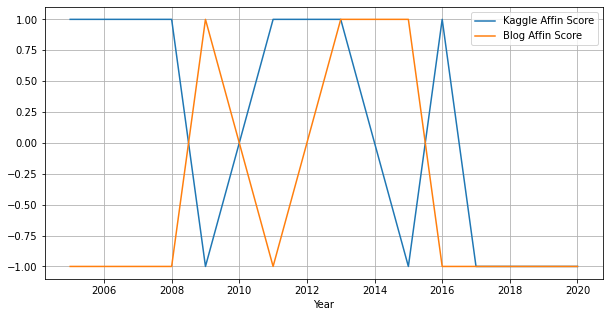

In [ ]:
Rihanna_finnal_df.plot(x="Year",y=['Kaggle Affin Score','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 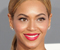  Beyoncé

In [ ]:
import matplotlib.pyplot as plt

Beyoncé_blog_df = blogs_result[blogs_result['Singer'] == 'Beyoncé' ]
Beyoncé_blog_df = Beyoncé_blog_df.sort_values(by=['Year'])

Beyoncé_kaggle_df = singers_df[singers_df['Artist'] == 'Beyoncé' ]
Beyoncé_kaggle_df = Beyoncé_kaggle_df.sort_values(by=['Year'])

year_dict = {}
for year in Beyoncé_kaggle_df['Year'].unique():
  year_df = Beyoncé_kaggle_df[Beyoncé_kaggle_df['Year'] == year]
  for tup in year_df.itertuples():
    if year not in year_dict.keys():
      year_dict[year] = tup[5]
    else:
      year_dict[year] += tup[5]


Beyoncé_dict = {}
for year in Beyoncé_blog_df['Year'].unique():
  if year in year_dict.keys() :
    Beyoncé_dict[year] = year_dict[year]

Beyoncé_kaggle_sum_of_years_df = pd.DataFrame(list(Beyoncé_dict.items()),columns = ['Year','Kaggle Affin Score'])
Beyoncé_finnal_df = pd.DataFrame(list(zip(  Beyoncé_kaggle_sum_of_years_df['Year'],Beyoncé_kaggle_sum_of_years_df['Kaggle Affin Score'],Beyoncé_blog_df['Blog Affin Score'],  )),columns = ['Year','Kaggle Affin Score','Blog Affin Score'])
Beyoncé_finnal_df['Kaggle Affin Score'] = Beyoncé_finnal_df['Kaggle Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Beyoncé_finnal_df['Blog Affin Score'] = Beyoncé_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)

Beyoncé_finnal_df

,Year,Kaggle Affin Score,Blog Affin Score
0,2002,1,1
1,2003,1,1
2,2004,1,1
3,2005,1,1
4,2006,1,1
5,2008,1,1
6,2010,1,1
7,2011,1,1
8,2012,1,1
9,2013,1,1


We can see a complete match. In general, she is a singer who is considered very successful and has positive song content

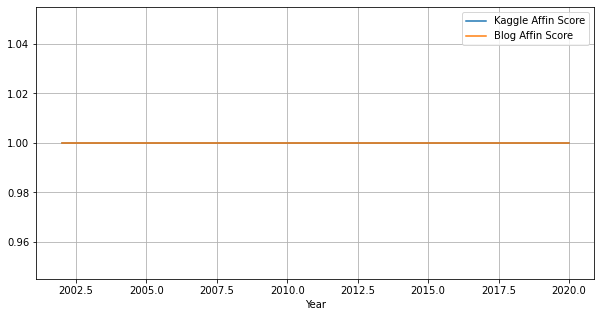

In [ ]:
Beyoncé_finnal_df.plot(x="Year",y=['Kaggle Affin Score','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

#### 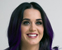 Katy Perry

In [ ]:
import matplotlib.pyplot as plt

Katy_Perry_blog_df = blogs_result[blogs_result['Singer'] == 'Katy Perry' ]
Katy_Perry_blog_df = Katy_Perry_blog_df.sort_values(by=['Year'])

Katy_Perry_kaggle_df = singers_df[singers_df['Artist'] == 'Katy Perry' ]
Katy_Perry_kaggle_df = Katy_Perry_kaggle_df.sort_values(by=['Year'])

year_dict = {}
for year in Katy_Perry_kaggle_df['Year'].unique():
  year_df = Katy_Perry_kaggle_df[Katy_Perry_kaggle_df['Year'] == year]
  for tup in year_df.itertuples():
    if year not in year_dict.keys():
      year_dict[year] = tup[5]
    else:
      year_dict[year] += tup[5]

Katy_Perry_dict = {}
for year in Katy_Perry_blog_df['Year'].unique():
  if year in year_dict.keys() :
    Katy_Perry_dict[year] = year_dict[year]

Katy_Perry_kaggle_sum_of_years_df = pd.DataFrame(list(Katy_Perry_dict.items()),columns = ['Year','Kaggle Affin Score'])
Katy_Perry_finnal_df = pd.DataFrame(list(zip(  Katy_Perry_kaggle_sum_of_years_df['Year'],Katy_Perry_kaggle_sum_of_years_df['Kaggle Affin Score'],Katy_Perry_blog_df['Blog Affin Score'],  )),columns = ['Year','Kaggle Affin Score','Blog Affin Score'])
Katy_Perry_finnal_df['Kaggle Affin Score'] = Katy_Perry_finnal_df['Kaggle Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Katy_Perry_finnal_df['Blog Affin Score'] = Katy_Perry_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)

Katy_Perry_finnal_df

,Year,Kaggle Affin Score,Blog Affin Score
0,2001,-1,1
1,2007,1,1
2,2008,1,1
3,2009,1,1
4,2010,1,1
5,2011,-1,1
6,2012,1,1
7,2013,1,1
8,2014,1,1
9,2015,1,1


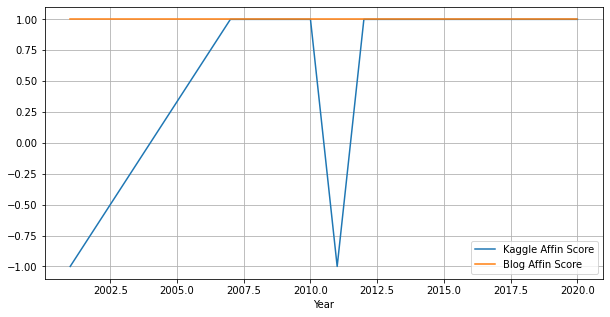

In [ ]:
Katy_Perry_finnal_df.plot(x="Year",y=['Kaggle Affin Score','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 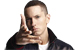 Eminem

In [ ]:
import matplotlib.pyplot as plt

Eminem_blog_df = blogs_result[blogs_result['Singer'] == 'Eminem' ]
Eminem_blog_df = Eminem_blog_df.sort_values(by=['Year'])

Eminem_kaggle_df = singers_df[singers_df['Artist'] == 'Eminem' ]
Eminem_kaggle_df = Eminem_kaggle_df.sort_values(by=['Year'])

year_dict = {}
for year in Eminem_kaggle_df['Year'].unique():
  year_df = Eminem_kaggle_df[Eminem_kaggle_df['Year'] == year]
  for tup in year_df.itertuples():
    if year not in year_dict.keys():
      year_dict[year] = tup[5]
    else:
      year_dict[year] += tup[5]

Eminem_dict = {}
for year in Eminem_blog_df['Year'].unique():
  if year in year_dict.keys() :
    Eminem_dict[year] = year_dict[year]

Eminem_kaggle_sum_of_years_df = pd.DataFrame(list(Eminem_dict.items()),columns = ['Year','Kaggle Affin Score'])

Eminem_finnal_df = pd.DataFrame(list(zip(  Eminem_kaggle_sum_of_years_df['Year'],Eminem_kaggle_sum_of_years_df['Kaggle Affin Score'],Eminem_blog_df['Blog Affin Score'],  )),columns = ['Year','Kaggle Affin Score','Blog Affin Score'])
Eminem_finnal_df['Kaggle Affin Score'] = Eminem_finnal_df['Kaggle Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Eminem_finnal_df['Blog Affin Score'] = Eminem_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)

Eminem_finnal_df

,Year,Kaggle Affin Score,Blog Affin Score
0,1996,-1,-1
1,1997,-1,-1
2,1999,-1,1
3,2000,-1,-1
4,2001,-1,-1
5,2002,-1,1
6,2003,-1,1
7,2004,-1,1
8,2006,-1,1
9,2007,1,1


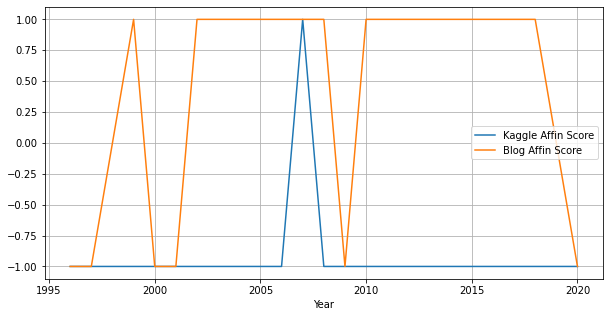

In [ ]:
Eminem_finnal_df.plot(x="Year",y=['Kaggle Affin Score','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 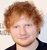 Ed Sheeran

In [ ]:
import matplotlib.pyplot as plt

Ed_Sheeran_blog_df = blogs_result[blogs_result['Singer'] == 'Ed Sheeran' ]
Ed_Sheeran_blog_df = Ed_Sheeran_blog_df.sort_values(by=['Year'])

Ed_Sheeran_kaggle_df = singers_df[singers_df['Artist'] == 'Ed Sheeran' ]
Ed_Sheeran_kaggle_df = Ed_Sheeran_kaggle_df.sort_values(by=['Year'])

year_dict = {}
for year in Ed_Sheeran_kaggle_df['Year'].unique():
  year_df = Ed_Sheeran_kaggle_df[Ed_Sheeran_kaggle_df['Year'] == year]
  for tup in year_df.itertuples():
    if year not in year_dict.keys():
      year_dict[year] = tup[5]
    else:
      year_dict[year] += tup[5]

Ed_Sheeran_dict = {}
for year in Ed_Sheeran_blog_df['Year'].unique():
  if year in year_dict.keys() :
    Ed_Sheeran_dict[year] = year_dict[year]

Ed_Sheeran_kaggle_sum_of_years_df = pd.DataFrame(list(Ed_Sheeran_dict.items()),columns = ['Year','Kaggle Affin Score'])
Ed_Sheeran_finnal_df = pd.DataFrame(list(zip(  Ed_Sheeran_kaggle_sum_of_years_df['Year'],Ed_Sheeran_kaggle_sum_of_years_df['Kaggle Affin Score'],Ed_Sheeran_blog_df['Blog Affin Score'],  )),columns = ['Year','Kaggle Affin Score','Blog Affin Score'])
Ed_Sheeran_finnal_df['Kaggle Affin Score'] = Ed_Sheeran_finnal_df['Kaggle Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Ed_Sheeran_finnal_df['Blog Affin Score'] = Ed_Sheeran_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)

Ed_Sheeran_finnal_df

,Year,Kaggle Affin Score,Blog Affin Score
0,2009,1,1
1,2010,1,1
2,2011,1,1
3,2013,-1,1
4,2014,1,1
5,2015,1,1
6,2016,1,1
7,2017,1,1
8,2018,1,1
9,2019,1,-1


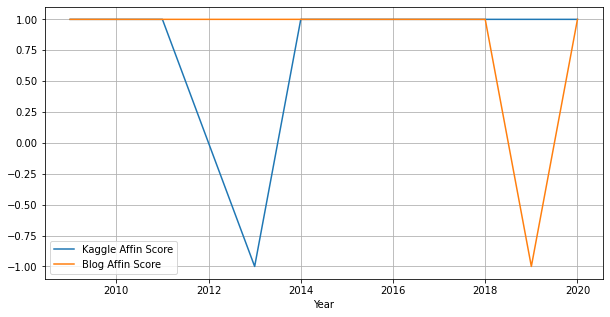

In [ ]:
Ed_Sheeran_finnal_df.plot(x="Year",y=['Kaggle Affin Score','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### **Populate the results in one graph**

In [ ]:
blogs_res_sum = blogs_result.loc[:,['Singer','Year', 'Blog Affin Score']].groupby(['Singer','Year'])['Blog Affin Score'].agg('sum').rename('Sum' ).reset_index()
blogs_res_sum = blogs_res_sum.sort_values(['Singer','Year'], ascending=True)
blogs_res_sum

In [ ]:
singers_df_sum = singers_df.loc[:,['Artist','Year','Affin Score']].groupby(['Artist','Year'])['Affin Score'].agg('sum').rename('Sum' ).reset_index()
singers_df_sum = singers_df_sum.sort_values(['Artist','Year'] , ascending=False)
singers_df_sum

In [ ]:
def filter(row):

   if (row['Sum_x'] >0   and  row['Sum_y'] >0) or (row['Sum_x'] <0   and  row['Sum_y'] < 0) :
    return True
   else:
    #  print(row)
     return False

df_union= blogs_res_sum.merge(singers_df_sum, left_on=['Singer','Year'] , right_on=['Artist','Year' ] )
df_union_filtered = df_union[df_union.apply(lambda row: filter(row) , axis = 1)]

maxCol=lambda x: max(x.min(), x.max(), key=abs)
df_union_filtered['max_score']=df_union_filtered[['Sum_x','Sum_y']].apply(maxCol,axis=1)
df_union_filtered['abs_score'] = abs(df_union_filtered['max_score'])

df_union_filtered = df_union_filtered.sort_values(['abs_score'] , ascending=False).iloc[:25,:]
df_union_filtered = df_union_filtered.sort_values(['Year'] , ascending=True)
df_union_filtered

In [ ]:
import turicreate as tc
import networkx as nx
import matplotlib.pyplot as plt
%matplotlib inline

mstcomm = nx.DiGraph()


for i,edges in df_union_filtered.iterrows():
    mstcomm.add_edge(edges[0], edges[1], weight=edges[5])


print("Networkx: %s" % nx.info(mstcomm))
nx.write_gml(mstcomm, "SingersGraph.gml")

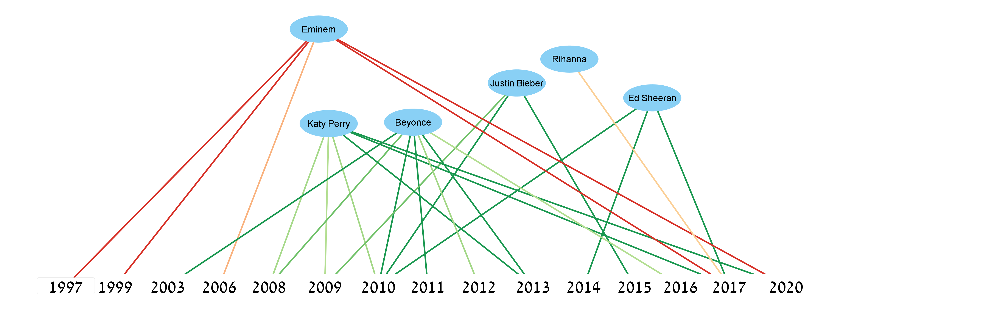

## 2️⃣ - Pictures comparison

df_Pictures_Grouped represents the DF of the singer pictures after we processed it - we created a new column of emotion matched to each singer picture.
So, for example, if the singer expresses a positive emotion, we will classify it with the number 1, otherwise, we will classify it with the number -1

### 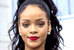 Rihanna comparison

In [ ]:
Rihanna_blog_df = blogs_result[blogs_result['Singer'] == 'Rihanna' ]
Rihanna_blog_df = Rihanna_blog_df.sort_values(by=['Year'])


Rihanna_blog_df['Blog Affin Score'] = Rihanna_blog_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Rihanna_blog_df['Singer'] = Rihanna_blog_df['Singer'].str.lower()


Rihanna_finnal_df = Rihanna_blog_df.merge(df_Pictures_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
Rihanna_finnal_df

,Singer,Year,Text,Blog Affin Score,Max,Sentiment,Sum
0,rihanna,2011,paid Ronald later told drunk said time outsid...,-1,2,-1,2
1,rihanna,2013,Malibu program revealed Stone Rihanna Rolling...,1,1,1,1
2,rihanna,2015,first happen Harper school told Rihanna survi...,1,14,-1,14
3,rihanna,2016,Billboard full Rihanna music released gave on...,-1,23,-1,23
4,rihanna,2017,unauthorized lost company Tavon called negoti...,-1,45,-1,45
5,rihanna,2019,female father musician failed success Complex...,-1,60,-1,60
6,rihanna,2020,Blast reports June trial jury set move due po...,-1,18,-1,18
7,rihanna,2022,event heckled boyfriend arriving someone Rock...,1,21,-1,21


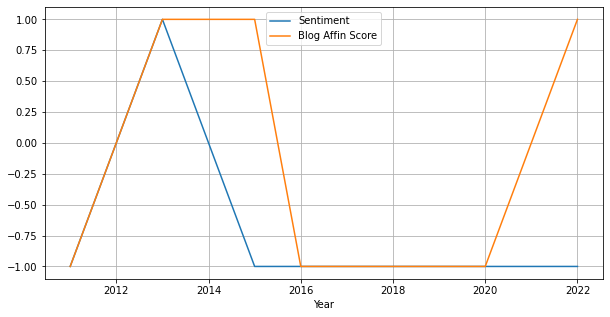

In [ ]:
import matplotlib.pyplot as plt

Rihanna_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 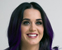  Katy Perry comparison

In [ ]:
KatyPerry_finnal_df = blogs_result[blogs_result['Singer'] == 'Katy Perry' ]
KatyPerry_finnal_df = KatyPerry_finnal_df.sort_values(by=['Year'])

KatyPerry_finnal_df['Blog Affin Score'] = KatyPerry_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
KatyPerry_finnal_df['Singer'] ='katyperry' # KatyPerry_finnal_df['Singer'].str.lower()

KatyPerry_finnal_df = KatyPerry_finnal_df.merge(df_Pictures_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
KatyPerry_finnal_df

,Singer,Year,Text,Blog Affin Score,Max,Sentiment,Sum
0,katyperry,2011,made long divorce Smurfs also filed December ...,1,1,-1,1
1,katyperry,2012,clips album edition scenes subject Perry youn...,1,19,1,19
2,katyperry,2013,Zoolander Ambassador Perry year Smurfs April ...,1,25,1,25
3,katyperry,2014,Gray Perry launched Ojukwu songwriters also f...,1,23,1,23
4,katyperry,2015,XLIX known Bowl show comedian Perry halftime ...,1,21,1,21
5,katyperry,2016,changed Records made Capitol name label Unsub...,1,10,1,10
6,katyperry,2017,studio Week show spot supporting September Pe...,1,59,-1,59
7,katyperry,2018,fell show September Perry sales season point ...,-1,66,1,66
8,katyperry,2019,beginning Diplo new July photo actor Bloom An...,1,93,1,93
9,katyperry,2020,federal British determining Ambassador year p...,-1,104,1,104


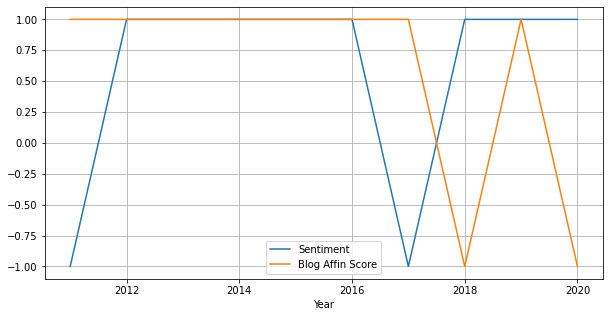

In [ ]:
import matplotlib.pyplot as plt

KatyPerry_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 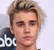 Justin Bieber comparison

In [ ]:
JustinBieber_finnal_df = blogs_result[blogs_result['Singer'] == 'Justin Bieber' ]
JustinBieber_finnal_df = JustinBieber_finnal_df.sort_values(by=['Year'])

JustinBieber_finnal_df['Blog Affin Score'] = JustinBieber_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
JustinBieber_finnal_df
JustinBieber_finnal_df['Singer'] ='justinbieber' # KatyPerry_finnal_df['Singer'].str.lower()

JustinBieber_finnal_df = JustinBieber_finnal_df.merge(df_Pictures_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
JustinBieber_finnal_df

,Singer,Year,Text,Blog Affin Score,Max,Sentiment,Sum
0,justinbieber,2012,year vacation April sold coming Mistletoe cop...,-1,1,1,1
1,justinbieber,2013,paid image spitting neighbor artist July trib...,-1,29,1,29
2,justinbieber,2014,January aposs influence California Bieber alc...,-1,22,-1,22
3,justinbieber,2015,helmed American million Skrillex selling Cana...,1,73,1,73
4,justinbieber,2016,dated enduring previously lot Justin GQ told ...,1,34,1,34
5,justinbieber,2017,final topping journey touch chart standing to...,-1,7,-1,7
6,justinbieber,2018,family welcomed September gotten Bay Hailey Y...,1,3,1,3
7,justinbieber,2019,million spring sales touring enjoyed worth Lo...,1,9,1,9
8,justinbieber,2020,recently release YouTube docuseries revealed ...,1,55,-1,55


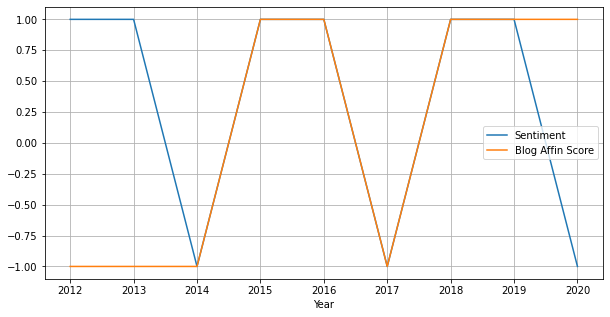

In [ ]:
import matplotlib.pyplot as plt

JustinBieber_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

## 3️⃣ - Tweets comparison

df_Tweets_Grouped represents the DF of the singer pictures after we processed it - we created a new column of emotion matched to each singer picture.
So, for example, if the singer expresses a positive emotion, we will classify it with the number 1, otherwise, we will classify it with the number -1

### 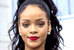 Rihanna comparison

In [ ]:
Rihanna_blog_df = blogs_result[blogs_result['Singer'] == 'Rihanna' ]
Rihanna_blog_df = Rihanna_blog_df.sort_values(by=['Year'])
Rihanna_blog_df['Blog Affin Score'] = Rihanna_blog_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
Rihanna_blog_df['Singer'] = Rihanna_blog_df['Singer'].str.lower()
Rihanna_finnal_df = Rihanna_blog_df.merge(df_Tweets_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
Rihanna_finnal_df

,Singer,Year,Text,Blog Affin Score,Sum,Sentiment
0,rihanna,2011,paid Ronald later told drunk said time outsid...,-1,1.0,-1
1,rihanna,2013,Malibu program revealed Stone Rihanna Rolling...,1,11.0,-1
2,rihanna,2015,first happen Harper school told Rihanna survi...,1,30.0,-1
3,rihanna,2016,Billboard full Rihanna music released gave on...,-1,48.0,-1
4,rihanna,2017,unauthorized lost company Tavon called negoti...,-1,38.0,-1
5,rihanna,2019,female father musician failed success Complex...,-1,226.0,1
6,rihanna,2020,Blast reports June trial jury set move due po...,-1,70.0,1
7,rihanna,2022,event heckled boyfriend arriving someone Rock...,1,51.0,1


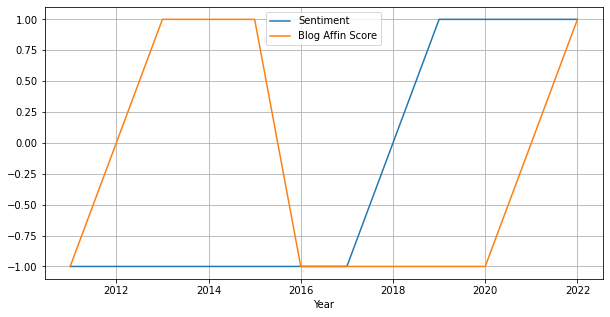

In [ ]:
import matplotlib.pyplot as plt

Rihanna_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 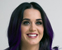  Katy Perry comparison

In [ ]:
KatyPerry_finnal_df = blogs_result[blogs_result['Singer'] == 'Katy Perry' ]
KatyPerry_finnal_df = KatyPerry_finnal_df.sort_values(by=['Year'])

KatyPerry_finnal_df['Blog Affin Score'] = KatyPerry_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
KatyPerry_finnal_df['Singer'] ='katyperry' # KatyPerry_finnal_df['Singer'].str.lower()

KatyPerry_finnal_df = KatyPerry_finnal_df.merge(df_Tweets_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
KatyPerry_finnal_df

,Singer,Year,Text,Blog Affin Score,Sum,Sentiment
0,katyperry,2011,made long divorce Smurfs also filed December ...,1,2.0,-1
1,katyperry,2012,clips album edition scenes subject Perry youn...,1,104.0,1
2,katyperry,2013,Zoolander Ambassador Perry year Smurfs April ...,1,117.0,1
3,katyperry,2014,Gray Perry launched Ojukwu songwriters also f...,1,62.0,1
4,katyperry,2015,XLIX known Bowl show comedian Perry halftime ...,1,57.0,1
5,katyperry,2016,changed Records made Capitol name label Unsub...,1,40.0,-1
6,katyperry,2017,studio Week show spot supporting September Pe...,1,179.0,1
7,katyperry,2018,fell show September Perry sales season point ...,-1,284.0,1
8,katyperry,2019,beginning Diplo new July photo actor Bloom An...,1,438.0,1
9,katyperry,2020,federal British determining Ambassador year p...,-1,795.0,1


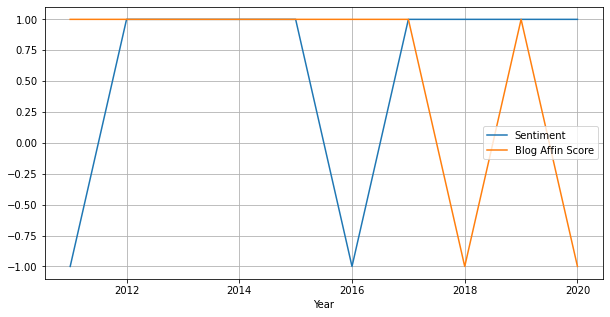

In [ ]:
import matplotlib.pyplot as plt

KatyPerry_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

### 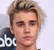 Justin Bieber comparison

In [ ]:
JustinBieber_finnal_df = blogs_result[blogs_result['Singer'] == 'Justin Bieber' ]
JustinBieber_finnal_df = JustinBieber_finnal_df.sort_values(by=['Year'])

JustinBieber_finnal_df['Blog Affin Score'] = JustinBieber_finnal_df['Blog Affin Score'].apply(lambda x: -1 if x < 0 else 1)
JustinBieber_finnal_df
JustinBieber_finnal_df['Singer'] ='justinbieber' # KatyPerry_finnal_df['Singer'].str.lower()

JustinBieber_finnal_df = JustinBieber_finnal_df.merge(df_Tweets_Grouped ,  left_on=['Singer','Year'] , right_on=['Singer','Year' ] )
JustinBieber_finnal_df

,Singer,Year,Text,Blog Affin Score,Sum,Sentiment
0,justinbieber,2012,year vacation April sold coming Mistletoe cop...,-1,12.0,-1
1,justinbieber,2013,paid image spitting neighbor artist July trib...,-1,112.0,1
2,justinbieber,2014,January aposs influence California Bieber alc...,-1,102.0,1
3,justinbieber,2015,helmed American million Skrillex selling Cana...,1,331.0,1
4,justinbieber,2016,dated enduring previously lot Justin GQ told ...,1,102.0,1
5,justinbieber,2017,final topping journey touch chart standing to...,-1,21.0,-1
6,justinbieber,2018,family welcomed September gotten Bay Hailey Y...,1,5.0,-1
7,justinbieber,2019,million spring sales touring enjoyed worth Lo...,1,41.0,-1
8,justinbieber,2020,recently release YouTube docuseries revealed ...,1,195.0,1


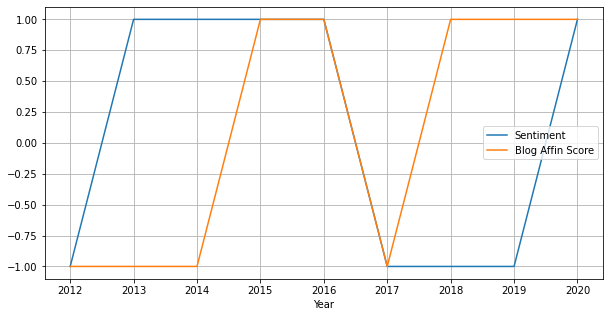

In [ ]:
import matplotlib.pyplot as plt

JustinBieber_finnal_df.plot(x="Year",y=['Sentiment','Blog Affin Score'],figsize=(10,5), grid=True)
plt.show()

# Linkes

---
**Sources of information culture -**




*   [Kaggle - songs lyrics](https://www.kaggle.com/datasets/deepshah16/song-lyrics-dataset)



> We took from Twitter pages of singers and from their Twitter page we gathered two different sources of information:

> 1 - Information source of tweets (text)

> 2 - Information source of the singers' photos



*   [Justin Bieber tweeter page](https://twitter.com/justinbieber)
*   [Rihanna tweeter page](https://twitter.com/rihanna)
*   [Katy Perry tweeter page](https://twitter.com/katyperry)
*   [Ed Sheeran tweeter page](https://twitter.com/edsheeran)



*   [Pictures dataset](https://res.cloudinary.com/dfgjujaok/raw/upload/v1661088865/Singers_Images_sm0ugl.txt)




**Timelife events - sources -**
*   [Rihanna blog](https://www.nickiswift.com/194782/the-tragic-real-life-story-of-rihanna/)
*   [Beyoncé blog](https://www.biography.com/musician/beyonce-knowles)
*   [Katy Perry blog](https://www.biography.com/musician/katy-perry)
*   [Ed Sheeran blog](https://www.biography.com/musician/ed-sheeran)
*   [Eminem blog](https://www.biography.com/musician/eminem)
*   [Justin Bieber blog](https://www.biography.com/musician/justin-bieber)